In [1]:
import warnings
warnings.filterwarnings('ignore')

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
from sklearn.metrics import confusion_matrix, roc_auc_score, log_loss
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.ensemble import GradientBoostingClassifier

In [2]:
pd.set_option('display.max_columns', None)

In [3]:
df = pd.read_csv("Bank Data.csv")
df.head()

,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Type_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance
0,0x160a,CUS_0xd40,September,Aaron Maashoh,23,821-00-0265,Scientist,19114.12,1824.843333,3,4,3,4,"Auto Loan, Credit-Builder Loan, Personal Loan,...",3,7,11.27,2022.0,Good,809.98,35.030402,22 Years and 9 Months,No,49.574949,236.64268203272135,Low_spent_Small_value_payments,186.26670208571772
1,0x160b,CUS_0xd40,October,Aaron Maashoh,24,821-00-0265,Scientist,19114.12,1824.843333,3,4,3,4,"Auto Loan, Credit-Builder Loan, Personal Loan,...",3,9,13.27,4.0,Good,809.98,33.053114,22 Years and 10 Months,No,49.574949,21.465380264657146,High_spent_Medium_value_payments,361.44400385378196
2,0x160c,CUS_0xd40,November,Aaron Maashoh,24,821-00-0265,Scientist,19114.12,1824.843333,3,4,3,4,"Auto Loan, Credit-Builder Loan, Personal Loan,...",-1,4,12.27,4.0,Good,809.98,33.811894,NaN,No,49.574949,148.23393788500925,Low_spent_Medium_value_payments,264.67544623342997
3,0x160d,CUS_0xd40,December,Aaron Maashoh,24_,821-00-0265,Scientist,19114.12,NaN,3,4,3,4,"Auto Loan, Credit-Builder Loan, Personal Loan,...",4,5,11.27,4.0,Good,809.98,32.430559,23 Years and 0 Months,No,49.574949,39.08251089460281,High_spent_Medium_value_payments,343.82687322383634
4,0x1616,CUS_0x21b1,September,Rick Rothackerj,28,004-07-5839,_______,34847.84,3037.986667,2,4,6,1,Credit-Builder Loan,3,1,5.42,5.0,Good,605.03,25.926822,27 Years and 3 Months,No,18.816215,39.684018417945296,High_spent_Large_value_payments,485.2984336755923


In [4]:
df.isnull().sum()

ID                             0
Customer_ID                    0
Month                          0
Name                        5015
Age                            0
SSN                            0
Occupation                     0
Annual_Income                  0
Monthly_Inhand_Salary       7498
Num_Bank_Accounts              0
Num_Credit_Card                0
Interest_Rate                  0
Num_of_Loan                    0
Type_of_Loan                5704
Delay_from_due_date            0
Num_of_Delayed_Payment      3498
Changed_Credit_Limit           0
Num_Credit_Inquiries        1035
Credit_Mix                     0
Outstanding_Debt               0
Credit_Utilization_Ratio       0
Credit_History_Age          4470
Payment_of_Min_Amount          0
Total_EMI_per_month            0
Amount_invested_monthly     2271
Payment_Behaviour              0
Monthly_Balance              562
dtype: int64

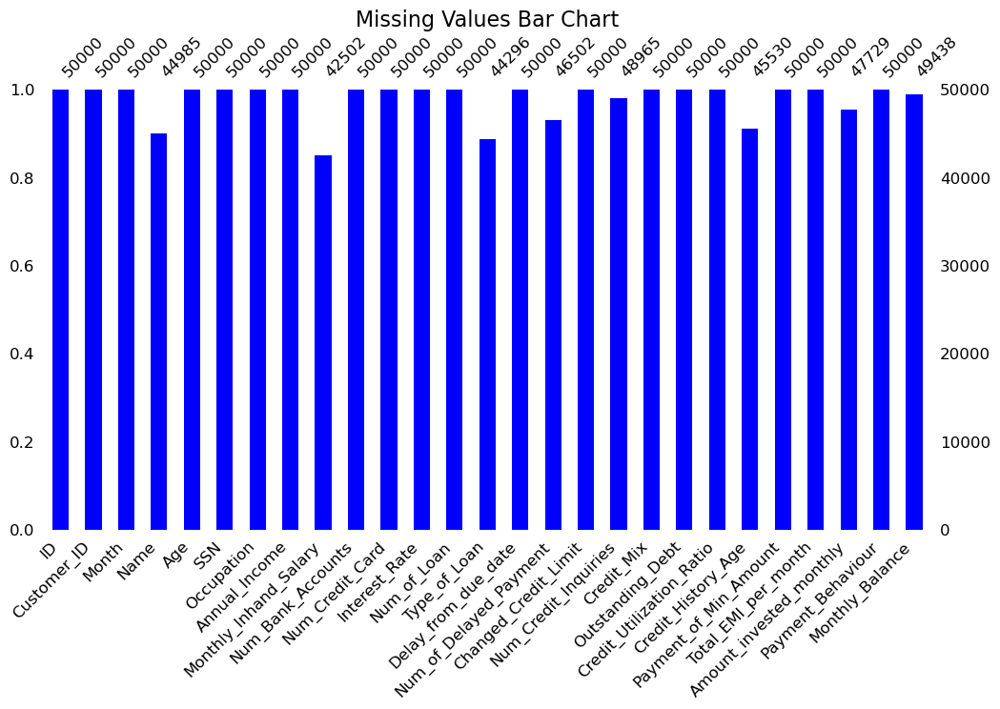

In [5]:
import missingno as msno

# Generate the missing values bar chart
msno.bar(df, figsize=(12, 6), color='blue', fontsize=12)
plt.title('Missing Values Bar Chart', fontsize=16)
plt.show()

In [6]:
# df.drop(columns=['ID','Customer_ID','SSN','Name','Type_of_Loan','Payment_Behaviour'],inplace=True)
# df.head()

In [7]:
df.shape

(50000, 27)

In [8]:
# Finding unique values in the columns
for column in df.columns:
    print('*************************', column, '********************')
    print()
    unique_values = list(set(df[column]))
    print(unique_values[:110])  # Displaying the first 10 unique values
    print()


************************* ID ********************

['0x1c3cc', '0xcbf7', '0x4b4c', '0x8a0e', '0x19cc0', '0x2fc9', '0x121b4', '0x1a620', '0x1d585', '0x2422b', '0x3d22', '0x34e5', '0x120b7', '0x133ef', '0x16bcf', '0x1aab7', '0x80f8', '0x1eb5a', '0x25768', '0x24b39', '0x5b52', '0x12f27', '0x23bc0', '0xb5b3', '0xbcbc', '0xceae', '0x14bd7', '0x2059b', '0x4a20', '0x235be', '0xe37e', '0x183dd', '0x5615', '0x8eca', '0xaffc', '0xd2c2', '0xb817', '0x1ab5f', '0x170de', '0x1e7b3', '0x96cf', '0xaf9a', '0x19b95', '0x1699a', '0x2101b', '0x793a', '0x17b18', '0xcff5', '0xbbfb', '0x6e69', '0x18034', '0x1516c', '0xb433', '0x20740', '0x1dfc9', '0x163b', '0x3ebd', '0x5429', '0x186dd', '0xb8e3', '0x4768', '0x181e3', '0x1a096', '0x1d763', '0x3cf5', '0x11e30', '0x5ff9', '0x5b78', '0xbe83', '0xc85c', '0x14a27', '0x1c9ef', '0x25265', '0x254c9', '0x10137', '0x51dd', '0xd00a', '0x60e7', '0x1ed5e', '0x2b31', '0x110b0', '0x1ae5e', '0x142d6', '0x1c174', '0x7468', '0x1eb68', '0x1aba', '0x6453', '0xf0b9', '0x1446e', '

# Cleaning Age Column

In [9]:
import re

# Define a regular expression to match non-numerical values
non_numerical_pattern = re.compile(r'\D+')

# Identify non-numerical values in the 'Age' column
non_numerical_values = df['Age'][df['Age'].apply(lambda x: bool(non_numerical_pattern.search(str(x))))].unique()
non_numerical_values


array(['24_', '41_', '40_', '32_', '42_', '33_', '38_', '-500', '37_',
       '19_', '21_', '46_', '22_', '20_', '35_', '8327_', '29_', '28_',
       '26_', '43_', '18_', '47_', '48_', '34_', '50_', '4610_', '27_',
       '31_', '36_', '45_', '51_', '39_', '25_', '52_', '55_', '23_',
       '30_', '44_', '17_', '56_', '53_', '16_', '2077_', '15_', '49_',
       '14_', '54_', '4943_', '619_', '2511_', '6647_', '5026_', '8245_',
       '2336_', '2926_', '8200_', '1916_', '8631_', '6400_', '4938_',
       '6470_', '1776_', '2389_', '914_', '6453_', '1882_', '7044_',
       '1018_', '1841_', '5714_', '4698_', '1210_', '3513_', '128_',
       '2974_', '7406_', '299_', '6031_', '909_', '6621_', '3474_',
       '831_', '217_', '8340_', '7868_', '1401_'], dtype=object)

In [10]:
replacement_mapping = {
    '24_': 24, '41_': 41, '40_': 40, '32_': 32, '42_': 42, '33_': 33, '38_': 38, '-500': 500, '37_': 37,
    '19_': 19, '21_': 21, '46_': 46, '22_': 22, '20_': 20, '35_': 35, '8327_': 8327, '29_': 29, '28_': 28,
    '26_': 26, '43_': 43, '18_': 18, '47_': 47, '48_': 48, '34_': 34, '50_': 50, '4610_': 4610, '27_': 27,
    '31_': 31, '36_': 36, '45_': 45, '51_': 51, '39_': 39, '25_': 25, '52_': 52, '55_': 55, '23_': 23,
    '30_': 30, '44_': 44, '17_': 17, '56_': 56, '53_': 53, '16_': 16, '2077_': 2077, '15_': 15, '49_': 49,
    '14_': 14, '54_': 54, '4943_': 4943, '619_': 619, '2511_': 2511, '6647_': 6647, '5026_': 5026, '8245_': 8245,
    '2336_': 2336, '2926_': 2926, '8200_': 8200, '1916_': 1916, '8631_': 8631, '6400_': 6400, '4938_': 4938,
    '6470_': 6470, '1776_': 1776, '2389_': 2389, '914_': 914, '6453_': 6453, '1882_': 1882, '7044_': 7044,
    '1018_': 1018, '1841_': 1841, '5714_': 5714, '4698_': 4698, '1210_': 1210, '3513_': 3513, '128_': 128,
    '2974_': 2974, '7406_': 7406, '299_': 299, '6031_': 6031, '909_': 909, '6621_': 6621, '3474_': 3474,
    '831_': 831, '217_': 217, '8340_': 8340, '7868_': 7868, '1401_': 1401
}

df['Age'].replace(replacement_mapping, inplace=True)


# Cleaning Occupation column

In [11]:
df['Occupation'].replace('_______', np.nan, inplace=True)

df.Occupation.value_counts()

Lawyer           3324
Engineer         3212
Architect        3195
Mechanic         3168
Developer        3146
Accountant       3133
Media_Manager    3130
Scientist        3104
Teacher          3103
Entrepreneur     3103
Journalist       3037
Doctor           3027
Manager          3000
Musician         2947
Writer           2933
Name: Occupation, dtype: int64

# Cleaning Annual_Income Column

In [12]:
import re

# Define a regular expression to match non-numerical values
non_numerical_pattern = re.compile(r'[^0-9.]')

# Identify non-numerical values in the 'Age' column
non_numerical_values_of_annual_income = df['Annual_Income'][df['Annual_Income'].apply(lambda x: bool(non_numerical_pattern.search(str(x))))].unique()

for value in non_numerical_values_of_annual_income:
    print(value)


92047.08_
10183.015_
71681.4_
29469.98_
30788.44_
14165.23_
14129.76_
123732.32_
19981.6_
60162.1_
18681.465_
9841.34_
31021.24_
15398.95_
144881.68_
17759.1_
134321.44_
66528.24_
19777.05_
20188.02_
41345.58_
140014.36_
37071.2_
34766.06_
30272.61_
59971.42_
28681.38_
15488.885_
19853.35_
9133.045_
19283.47_
9444.795_
124419.66_
11970.955_
32314.44_
61235.6_
29999.94_
52972.5_
25530.33_
39696.98_
76087.68_
14224.655_
27063.43_
36980.1_
7709.625_
29042.45_
20540.49_
116594.91_
82289.36_
65778.22_
19180.87_
44386.47_
30197.28_
118172.63999999998_
35133.49_
55719.18000000001_
34841.87_
83845.7_
108415.0_
32663.41_
48411.24_
33314.96_
177150.4_
110264.0_
32128.24_
94511.79_
53916.84_
20502.64_
55000.62_
50811.27_
18549.28_
134810.13_
14884.465_
31732.61_
56760.51_
17853.5_
31087.66_
132414.16_
82998.24_
34927.0_
94052.22_
20639.79_
16133803.0_
68742.75_
8365.075_
12613.56_
29625.82_
14976.45_
82454.0_
19653.005_
41543.64_
21720.955_
38107.36_
20308.26_
44483.64_
8875.135_
6756952.0_
48608

In [13]:
# Remove underscores and convert to float
cleaned_income_values = [float(value.replace('_', '')) for value in non_numerical_values_of_annual_income]

# Print the cleaned values
print(cleaned_income_values)


[92047.08, 10183.015, 71681.4, 29469.98, 30788.44, 14165.23, 14129.76, 123732.32, 19981.6, 60162.1, 18681.465, 9841.34, 31021.24, 15398.95, 144881.68, 17759.1, 134321.44, 66528.24, 19777.05, 20188.02, 41345.58, 140014.36, 37071.2, 34766.06, 30272.61, 59971.42, 28681.38, 15488.885, 19853.35, 9133.045, 19283.47, 9444.795, 124419.66, 11970.955, 32314.44, 61235.6, 29999.94, 52972.5, 25530.33, 39696.98, 76087.68, 14224.655, 27063.43, 36980.1, 7709.625, 29042.45, 20540.49, 116594.91, 82289.36, 65778.22, 19180.87, 44386.47, 30197.28, 118172.63999999998, 35133.49, 55719.18000000001, 34841.87, 83845.7, 108415.0, 32663.41, 48411.24, 33314.96, 177150.4, 110264.0, 32128.24, 94511.79, 53916.84, 20502.64, 55000.62, 50811.27, 18549.28, 134810.13, 14884.465, 31732.61, 56760.51, 17853.5, 31087.66, 132414.16, 82998.24, 34927.0, 94052.22, 20639.79, 16133803.0, 68742.75, 8365.075, 12613.56, 29625.82, 14976.45, 82454.0, 19653.005, 41543.64, 21720.955, 38107.36, 20308.26, 44483.64, 8875.135, 6756952.0, 4860

In [14]:
non_numerical_pattern = re.compile(r'[^0-9.]')


def clean_and_convert(value):
    return float(re.sub(non_numerical_pattern, '', str(value)))

# Apply the function to the 'Annual_Income' column
df['Annual_Income'] = df['Annual_Income'].apply(clean_and_convert)

df['Annual_Income'].sample(20)

35901     36886.06
2021      35670.66
43208     22385.16
24503     31638.50
14019     19769.99
35103     31748.67
5225      16538.39
20525    158952.84
17589     32027.38
34849     45144.80
32440     29777.30
30839     93898.05
46699      9298.42
40213     81822.80
36417     69073.65
21139     36779.90
45457      9743.51
33655     29410.64
28560     55670.07
12561     56301.90
Name: Annual_Income, dtype: float64

# Cleaning Monthly_Inhand_Salary column

In [15]:
non_numerical_pattern = re.compile(r'[^0-9.]')


non_numerical_values_of_Monthly_Inhand_Salary = df['Monthly_Inhand_Salary'][df['Monthly_Inhand_Salary'].apply(lambda x: bool(non_numerical_pattern.search(str(x))))].unique()

for value in non_numerical_values_of_Monthly_Inhand_Salary:
    print(value)


nan


# Claenign Num_Bank_Accounts column

In [16]:
non_numerical_pattern = re.compile(r'[^0-9.]')


non_numerical_values_of_Num_Bank_Accounts = df['Num_Bank_Accounts'][df['Num_Bank_Accounts'].apply(lambda x: bool(non_numerical_pattern.search(str(x))))].unique()

for value in non_numerical_values_of_Num_Bank_Accounts:
    print(value)


-1


In [17]:
df['Num_Bank_Accounts'].replace('-1', np.nan, inplace=True)

df.Num_Bank_Accounts.value_counts()

6       6504
7       6408
8       6387
4       6100
5       6068
        ... 
855        1
1262       1
908        1
603        1
1727       1
Name: Num_Bank_Accounts, Length: 540, dtype: int64

# Cleaning Num_Credit_Card column

In [18]:
non_numerical_pattern = re.compile(r'[^0-9.]')


non_numerical_values_of_Num_of_Loan = df['Num_of_Loan'][df['Num_of_Loan'].apply(lambda x: bool(non_numerical_pattern.search(str(x))))].unique()

non_numerical_values_of_Num_of_Loan


array(['-100', '5_', '1_', '2_', '6_', '4_', '0_', '7_', '3_', '8_', '9_',
       '481_', '954_', '725_', '72_', '734_', '519_', '1292_', '1296_'],
      dtype=object)

In [19]:
replacement_mapping = {
    '-100': 100, '5_': 5, '1_': 1, '2_': 2, '6_': 6, '4_': 4, '0_': 0, '7_': 7, '3_': 3, '8_': 8, '9_': 9,
       '481_': 481, '954_': 954, '725_': 725, '72_': 72, '734_': 734, '519_': 519, '1292_': 1292, '1296_': 1296
      
}

df['Num_Credit_Card'].replace(replacement_mapping, inplace=True)

# Cleaning Num_of_Delayed_Payment column

In [20]:
non_numerical_pattern = re.compile(r'[^0-9.]')


non_numerical_values_of_Num_of_Delayed_Payment = df['Num_of_Delayed_Payment'][df['Num_of_Delayed_Payment'].apply(lambda x: bool(non_numerical_pattern.search(str(x))))].unique()

non_numerical_values_of_Num_of_Delayed_Payment


array([nan, '2_', '20_', '6_', '11_', '15_', '10_', '9_', '25_', '17_',
       '1_', '-1', '0_', '-2', '8_', '12_', '16_', '19_', '18_', '24_',
       '7_', '28_', '-1_', '14_', '13_', '-3', '21_', '5_', '22_', '3_',
       '-2_', '23_', '4_', '2503_', '227_', '26_', '3508_', '975_', '-3_',
       '2817_', '2344_', '4091_', '3565_', '2148_', '2055_', '3392_',
       '481_', '97_', '3843_'], dtype=object)

In [21]:
replacement_mapping = {
    '2_': 2, '20_': 20, '6_': 6, '11_': 11, '15_': 15, '10_': 10, '9_': 9, '25_': 25, '17_': 17,
    '1_': 1, '0_': 0, '8_': 8, '12_': 12, '16_': 16, '19_': 19, '18_': 18, '24_': 24,
    '7_': 7, '28_': 28, '-1_': -1, '14_': 14, '13_': 13, '21_': 21, '5_': 5, '22_': 22, '3_': 3,
    '-2_': -2, '23_': 23, '4_': 4, '2503_': 2503, '227_': 227, '26_': 26, '3508_': 3508, '975_': 975, '-3_': -3,
    '2817_': 2817, '2344_': 2344, '4091_': 4091, '3565_': 3565, '2148_': 2148, '2055_': 2055, '3392_': 3392,
    '481_': 481, '97_': 97, '3843_': 3843
}

df['Num_of_Delayed_Payment'].replace(replacement_mapping, inplace=True)


# Cleaning Changed_Credit_Limit Column

In [22]:
non_numerical_pattern = re.compile(r'[^0-9.]')


non_numerical_values_of_Changed_Credit_Limit = df['Changed_Credit_Limit'][df['Changed_Credit_Limit'].apply(lambda x: bool(non_numerical_pattern.search(str(x))))].unique()

non_numerical_values_of_Changed_Credit_Limit


array(['_', '-0.2400000000000002', '-6.14', '-5.78', '-2.48', '-4.51',
       '-1.25', '-2.47', '-3.47', '-4.1099999999999985',
       '-0.3700000000000001', '-2.9000000000000004',
       '-0.049999999999999815', '-6.2', '-3.72', '-5.3100000000000005',
       '-3.06', '-0.5999999999999996', '-0.5800000000000001', '-5.76',
       '-3.78', '-0.3799999999999999', '-2.25', '-2.03', '-2.67', '-3.59',
       '-3.22', '-0.5199999999999996', '-0.18999999999999995',
       '-1.2599999999999998', '-1.22', '-2.02', '-3.08', '-2.08', '-3.92',
       '-3.13', '-4.12', '-5.45', '-2.84', '-1.59', '-3.18', '-1.95',
       '-0.48', '-3.9', '-0.6000000000000001', '-1.4699999999999998',
       '-2.31', '-0.98', '-2.35', '-5.41', '-6.41', '-4.7', '-2.87',
       '-1.98', '-4.98', '-2.18', '-4.39', '-0.4099999999999999',
       '-0.8799999999999999', '-1.05', '-1.81', '-1.5499999999999998',
       '-4.93', '-0.77', '-2.05', '-3.28', '-0.9699999999999998',
       '-0.16000000000000014', '-2.5', '-4.13', '-0

In [23]:
df['Changed_Credit_Limit'].replace('_', np.nan, inplace=True)

df.Changed_Credit_Limit.value_counts()

11.5     70
11.32    63
7.35     60
7.01     60
10.06    57
         ..
31.51     1
-3.92     1
28.07     1
26.38     1
29.17     1
Name: Changed_Credit_Limit, Length: 3926, dtype: int64

# Cleaning Credit_Mix column

In [24]:
df.Credit_Mix.value_counts().head(10)

Standard    18379
Good        12260
_            9805
Bad          9556
Name: Credit_Mix, dtype: int64

In [25]:
# Assuming df is your DataFrame
df['Credit_Mix'].replace('_', 'neutral', inplace=True)
df['Credit_Mix'].fillna('neutral', inplace=True)


In [26]:
df.Credit_Mix.value_counts().head(10)

Standard    18379
Good        12260
neutral      9805
Bad          9556
Name: Credit_Mix, dtype: int64

# Cleaning Outstanding_Debt column

In [27]:
non_numerical_pattern = re.compile(r'[^0-9.]')


non_numerical_values_of_Outstanding_Debt = df['Outstanding_Debt'][df['Outstanding_Debt'].apply(lambda x: bool(non_numerical_pattern.search(str(x))))].unique()

non_numerical_values_of_Outstanding_Debt


array(['1303.01_', '3053.16_', '2431.64_', '1045.11_', '4984.82_',
       '1973.63_', '1166.47_', '457.81_', '2593.23_', '133.3_',
       '3271.84_', '465.04_', '218.25_', '1340.41_', '4183.22_', '94.75_',
       '2526.03_', '2770.15_', '1100.42_', '1109.22_', '1215.09_',
       '105.26_', '3889.88_', '347.44_', '886.09_', '2042.27_', '164.66_',
       '1481.99_', '1443.78_', '1401.52_', '1099.66_', '748.76_',
       '606.78_', '1605.81_', '2412.6_', '642.22_', '428.67_', '259.63_',
       '2468.95_', '1.48_', '1137.41_', '174.79_', '1732.19_', '2296.23_',
       '1073.37_', '1343.5_', '2673.3_', '17.81_', '775.02_', '32.95_',
       '1200.67_', '2712.98_', '1576.95_', '834.51_', '1972.69_',
       '1396.03_', '752.66_', '975.21_', '288.34_', '503.63_', '1727.71_',
       '657.3_', '1415.37_', '1339.99_', '937.2_', '4299.1_', '434.31_',
       '1150.03_', '1201.93_', '473.56_', '560.58_', '2187.49_',
       '729.74_', '671.39_', '804.67_', '408.71_', '263.2_', '4625.22_',
       '172.1

In [28]:
non_numerical_pattern = re.compile(r'[^0-9.]')


def clean_and_convert(value):
    return float(re.sub(non_numerical_pattern, '', str(value)))

# Apply the function to the 'Annual_Income' column
df['Outstanding_Debt'] = df['Outstanding_Debt'].apply(clean_and_convert)


In [29]:
df.head()

,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Type_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance
0,0x160a,CUS_0xd40,September,Aaron Maashoh,23,821-00-0265,Scientist,19114.12,1824.843333,3,4,3,4,"Auto Loan, Credit-Builder Loan, Personal Loan,...",3,7,11.27,2022.0,Good,809.98,35.030402,22 Years and 9 Months,No,49.574949,236.64268203272135,Low_spent_Small_value_payments,186.26670208571772
1,0x160b,CUS_0xd40,October,Aaron Maashoh,24,821-00-0265,Scientist,19114.12,1824.843333,3,4,3,4,"Auto Loan, Credit-Builder Loan, Personal Loan,...",3,9,13.27,4.0,Good,809.98,33.053114,22 Years and 10 Months,No,49.574949,21.465380264657146,High_spent_Medium_value_payments,361.44400385378196
2,0x160c,CUS_0xd40,November,Aaron Maashoh,24,821-00-0265,Scientist,19114.12,1824.843333,3,4,3,4,"Auto Loan, Credit-Builder Loan, Personal Loan,...",-1,4,12.27,4.0,Good,809.98,33.811894,NaN,No,49.574949,148.23393788500925,Low_spent_Medium_value_payments,264.67544623342997
3,0x160d,CUS_0xd40,December,Aaron Maashoh,24,821-00-0265,Scientist,19114.12,NaN,3,4,3,4,"Auto Loan, Credit-Builder Loan, Personal Loan,...",4,5,11.27,4.0,Good,809.98,32.430559,23 Years and 0 Months,No,49.574949,39.08251089460281,High_spent_Medium_value_payments,343.82687322383634
4,0x1616,CUS_0x21b1,September,Rick Rothackerj,28,004-07-5839,NaN,34847.84,3037.986667,2,4,6,1,Credit-Builder Loan,3,1,5.42,5.0,Good,605.03,25.926822,27 Years and 3 Months,No,18.816215,39.684018417945296,High_spent_Large_value_payments,485.2984336755923


# Cleaning Amount_invested_monthly column

In [30]:
non_numerical_pattern = re.compile(r'[^0-9.]')


non_numerical_values_of_Amount_invested_monthly = df['Amount_invested_monthly'][df['Amount_invested_monthly'].apply(lambda x: bool(non_numerical_pattern.search(str(x))))].unique()

non_numerical_values_of_Amount_invested_monthly


array([nan, '__10000__'], dtype=object)

In [31]:
df['Amount_invested_monthly'].replace('__10000__', 10000, inplace=True)


# Cleaning Monthly_Balance column

In [32]:
non_numerical_pattern = re.compile(r'[^0-9.]')


non_numerical_values_of_Monthly_Balance = df['Monthly_Balance'][df['Monthly_Balance'].apply(lambda x: bool(non_numerical_pattern.search(str(x))))].unique()

non_numerical_values_of_Monthly_Balance


array([nan, '__-333333333333333333333333333__'], dtype=object)

In [33]:
df['Monthly_Balance'].replace('__-333333333333333333333333333__', np.nan, inplace=True)

# Convert String to Float of Credit_History_Age column also fill the null value with it's mean

*After doing a lot of analyis I have found all 'Credit_History_Age	' null cause I have to convert all of str to float/int value. For this operation 'Credit_History_Age' columns became null. But I need this column. So that I'm do it preprocessing. I have taken only integer value from this columns that would be standard*

In [34]:
def extract_age(row):
    if isinstance(row, str):
        years, months = 0, 0
        if 'Years' in row:
            years = int(row.split(' Years')[0])
        if 'Months' in row:
            months = int(row.split('and ')[1].split(' Months')[0])
        return years + months / 12
    else:
        return np.nan

df['Credit_History_Age'] = df['Credit_History_Age'].apply(extract_age)

# Fill missing values with the mean
mean_age = df['Credit_History_Age'].mean()
df['Credit_History_Age'].fillna(mean_age, inplace=True)

In [35]:
df.head(5)

,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Type_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance
0,0x160a,CUS_0xd40,September,Aaron Maashoh,23,821-00-0265,Scientist,19114.12,1824.843333,3,4,3,4,"Auto Loan, Credit-Builder Loan, Personal Loan,...",3,7,11.27,2022.0,Good,809.98,35.030402,22.750000,No,49.574949,236.64268203272135,Low_spent_Small_value_payments,186.26670208571772
1,0x160b,CUS_0xd40,October,Aaron Maashoh,24,821-00-0265,Scientist,19114.12,1824.843333,3,4,3,4,"Auto Loan, Credit-Builder Loan, Personal Loan,...",3,9,13.27,4.0,Good,809.98,33.053114,22.833333,No,49.574949,21.465380264657146,High_spent_Medium_value_payments,361.44400385378196
2,0x160c,CUS_0xd40,November,Aaron Maashoh,24,821-00-0265,Scientist,19114.12,1824.843333,3,4,3,4,"Auto Loan, Credit-Builder Loan, Personal Loan,...",-1,4,12.27,4.0,Good,809.98,33.811894,18.937598,No,49.574949,148.23393788500925,Low_spent_Medium_value_payments,264.67544623342997
3,0x160d,CUS_0xd40,December,Aaron Maashoh,24,821-00-0265,Scientist,19114.12,NaN,3,4,3,4,"Auto Loan, Credit-Builder Loan, Personal Loan,...",4,5,11.27,4.0,Good,809.98,32.430559,23.000000,No,49.574949,39.08251089460281,High_spent_Medium_value_payments,343.82687322383634
4,0x1616,CUS_0x21b1,September,Rick Rothackerj,28,004-07-5839,NaN,34847.84,3037.986667,2,4,6,1,Credit-Builder Loan,3,1,5.42,5.0,Good,605.03,25.926822,27.250000,No,18.816215,39.684018417945296,High_spent_Large_value_payments,485.2984336755923


# Checking If numerical values has such as String values in several columns

In [36]:
df.dtypes

ID                           object
Customer_ID                  object
Month                        object
Name                         object
Age                          object
SSN                          object
Occupation                   object
Annual_Income               float64
Monthly_Inhand_Salary       float64
Num_Bank_Accounts             int64
Num_Credit_Card               int64
Interest_Rate                 int64
Num_of_Loan                  object
Type_of_Loan                 object
Delay_from_due_date           int64
Num_of_Delayed_Payment       object
Changed_Credit_Limit         object
Num_Credit_Inquiries        float64
Credit_Mix                   object
Outstanding_Debt            float64
Credit_Utilization_Ratio    float64
Credit_History_Age          float64
Payment_of_Min_Amount        object
Total_EMI_per_month         float64
Amount_invested_monthly      object
Payment_Behaviour            object
Monthly_Balance              object
dtype: object

In [37]:
#find out numerical columns

df.select_dtypes(exclude=['object']).columns

Index(['Annual_Income', 'Monthly_Inhand_Salary', 'Num_Bank_Accounts',
       'Num_Credit_Card', 'Interest_Rate', 'Delay_from_due_date',
       'Num_Credit_Inquiries', 'Outstanding_Debt', 'Credit_Utilization_Ratio',
       'Credit_History_Age', 'Total_EMI_per_month'],
      dtype='object')

In [38]:
df.head(1)

,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Type_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance
0,0x160a,CUS_0xd40,September,Aaron Maashoh,23,821-00-0265,Scientist,19114.12,1824.843333,3,4,3,4,"Auto Loan, Credit-Builder Loan, Personal Loan,...",3,7,11.27,2022.0,Good,809.98,35.030402,22.75,No,49.574949,236.64268203272135,Low_spent_Small_value_payments,186.26670208571772


**Those columns shoud be numerical values but it has as string now I'm converting them**

In [39]:
# Assuming our DataFrame is named 'df'
columns_to_convert = ['Age', 'Num_of_Loan', 'Num_of_Delayed_Payment','Changed_Credit_Limit', 
                      'Amount_invested_monthly', 'Monthly_Balance']

# Convert selected columns to numeric types
df[columns_to_convert] = df[columns_to_convert].apply(pd.to_numeric, errors='coerce')


In [40]:
df.select_dtypes(exclude=['object']).columns

Index(['Age', 'Annual_Income', 'Monthly_Inhand_Salary', 'Num_Bank_Accounts',
       'Num_Credit_Card', 'Interest_Rate', 'Num_of_Loan',
       'Delay_from_due_date', 'Num_of_Delayed_Payment', 'Changed_Credit_Limit',
       'Num_Credit_Inquiries', 'Outstanding_Debt', 'Credit_Utilization_Ratio',
       'Credit_History_Age', 'Total_EMI_per_month', 'Amount_invested_monthly',
       'Monthly_Balance'],
      dtype='object')

In [41]:
#convert numerical columms into float

for i in df.select_dtypes(exclude=['object']).columns:
    df[i] = df[i].apply(lambda x: float(x))
    

df.dtypes

ID                           object
Customer_ID                  object
Month                        object
Name                         object
Age                         float64
SSN                          object
Occupation                   object
Annual_Income               float64
Monthly_Inhand_Salary       float64
Num_Bank_Accounts           float64
Num_Credit_Card             float64
Interest_Rate               float64
Num_of_Loan                 float64
Type_of_Loan                 object
Delay_from_due_date         float64
Num_of_Delayed_Payment      float64
Changed_Credit_Limit        float64
Num_Credit_Inquiries        float64
Credit_Mix                   object
Outstanding_Debt            float64
Credit_Utilization_Ratio    float64
Credit_History_Age          float64
Payment_of_Min_Amount        object
Total_EMI_per_month         float64
Amount_invested_monthly     float64
Payment_Behaviour            object
Monthly_Balance             float64
dtype: object

In [42]:
#find out non-numerical columns

df.select_dtypes(include=['object']).columns

Index(['ID', 'Customer_ID', 'Month', 'Name', 'SSN', 'Occupation',
       'Type_of_Loan', 'Credit_Mix', 'Payment_of_Min_Amount',
       'Payment_Behaviour'],
      dtype='object')

# Filling Missing Values

In [43]:
df.shape

(50000, 27)

In [44]:
df.isnull().sum()

ID                             0
Customer_ID                    0
Month                          0
Name                        5015
Age                            0
SSN                            0
Occupation                  3438
Annual_Income                  0
Monthly_Inhand_Salary       7498
Num_Bank_Accounts              0
Num_Credit_Card                0
Interest_Rate                  0
Num_of_Loan                 2436
Type_of_Loan                5704
Delay_from_due_date            0
Num_of_Delayed_Payment      3498
Changed_Credit_Limit        1059
Num_Credit_Inquiries        1035
Credit_Mix                     0
Outstanding_Debt               0
Credit_Utilization_Ratio       0
Credit_History_Age             0
Payment_of_Min_Amount          0
Total_EMI_per_month            0
Amount_invested_monthly     2271
Payment_Behaviour              0
Monthly_Balance              568
dtype: int64

In [45]:
from sklearn.impute import SimpleImputer

# Step 1: Perform mode imputation for non-numeric attributes
non_numeric_columns = df.select_dtypes(include=['object']).columns
imputer_non_numeric = SimpleImputer(strategy='most_frequent')

df[non_numeric_columns] = imputer_non_numeric.fit_transform(df[non_numeric_columns])
df.head(2)

,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Type_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance
0,0x160a,CUS_0xd40,September,Aaron Maashoh,23.0,821-00-0265,Scientist,19114.12,1824.843333,3.0,4.0,3.0,4.0,"Auto Loan, Credit-Builder Loan, Personal Loan,...",3.0,7.0,11.27,2022.0,Good,809.98,35.030402,22.750000,No,49.574949,236.642682,Low_spent_Small_value_payments,186.266702
1,0x160b,CUS_0xd40,October,Aaron Maashoh,24.0,821-00-0265,Scientist,19114.12,1824.843333,3.0,4.0,3.0,4.0,"Auto Loan, Credit-Builder Loan, Personal Loan,...",3.0,9.0,13.27,4.0,Good,809.98,33.053114,22.833333,No,49.574949,21.465380,High_spent_Medium_value_payments,361.444004


In [46]:
df.isnull().sum()

ID                             0
Customer_ID                    0
Month                          0
Name                           0
Age                            0
SSN                            0
Occupation                     0
Annual_Income                  0
Monthly_Inhand_Salary       7498
Num_Bank_Accounts              0
Num_Credit_Card                0
Interest_Rate                  0
Num_of_Loan                 2436
Type_of_Loan                   0
Delay_from_due_date            0
Num_of_Delayed_Payment      3498
Changed_Credit_Limit        1059
Num_Credit_Inquiries        1035
Credit_Mix                     0
Outstanding_Debt               0
Credit_Utilization_Ratio       0
Credit_History_Age             0
Payment_of_Min_Amount          0
Total_EMI_per_month            0
Amount_invested_monthly     2271
Payment_Behaviour              0
Monthly_Balance              568
dtype: int64

**Work wiht Monthly_Inhand_Salary columns and fill all missing rows by it's mean**

In [47]:
df['Monthly_Inhand_Salary'].value_counts().tail(45)

1792.315000     1
1916.121667     1
1966.027083     1
6617.557500     1
3158.531385     1
2714.053557     1
9477.328612     1
7405.809676     1
3303.945000     1
7005.635000     1
873.865417      1
8343.470000     1
6765.796667     1
6204.196083     1
1158.442083     1
8188.211724     1
3750.272500     1
2836.380833     1
8717.732500     1
7823.998705     1
12318.281290    1
2438.323333     1
1801.474167     1
1497.882500     1
926.473333      1
3312.502174     1
14241.603333    1
8437.365531     1
887.077917      1
1488.550000     1
5708.490000     1
4473.288333     1
3792.167500     1
1183.864167     1
11643.130049    1
6107.183333     1
683.253333      1
1039.349084     1
689.187083      1
1652.952966     1
12386.966240    1
5993.870000     1
6763.330000     1
7729.695181     1
2312.785000     1
Name: Monthly_Inhand_Salary, dtype: int64

In [48]:
df['Monthly_Inhand_Salary'].mean()

4182.0042912035815

In [49]:

average_monthly_salary = df['Monthly_Inhand_Salary'].mean()
df['Monthly_Inhand_Salary'].fillna(value=average_monthly_salary, inplace=True)

df.isnull().sum()


ID                             0
Customer_ID                    0
Month                          0
Name                           0
Age                            0
SSN                            0
Occupation                     0
Annual_Income                  0
Monthly_Inhand_Salary          0
Num_Bank_Accounts              0
Num_Credit_Card                0
Interest_Rate                  0
Num_of_Loan                 2436
Type_of_Loan                   0
Delay_from_due_date            0
Num_of_Delayed_Payment      3498
Changed_Credit_Limit        1059
Num_Credit_Inquiries        1035
Credit_Mix                     0
Outstanding_Debt               0
Credit_Utilization_Ratio       0
Credit_History_Age             0
Payment_of_Min_Amount          0
Total_EMI_per_month            0
Amount_invested_monthly     2271
Payment_Behaviour              0
Monthly_Balance              568
dtype: int64

**Age never could be negative so that I remove all negative valuse and fill it's by it's mean**

In [50]:
df['Age'].value_counts().head(45)

39.0     1570
32.0     1529
44.0     1500
22.0     1493
35.0     1483
37.0     1461
27.0     1457
29.0     1441
20.0     1432
26.0     1421
28.0     1415
41.0     1411
30.0     1410
36.0     1400
25.0     1395
24.0     1381
19.0     1355
42.0     1353
33.0     1351
38.0     1340
31.0     1332
21.0     1321
34.0     1301
23.0     1273
45.0     1271
43.0     1255
40.0     1248
46.0     1189
18.0      834
15.0      781
16.0      774
17.0      758
50.0      698
53.0      685
49.0      670
55.0      668
47.0      660
54.0      655
51.0      649
52.0      629
48.0      621
56.0      536
500.0     464
14.0      191
914.0       3
Name: Age, dtype: int64

In [51]:
df['Age'] = df['Age'].apply(lambda x: x if (x >= 0 and x <= 100) else np.nan)
mean_age = df['Age'].mean()
df['Age'].fillna(mean_age, inplace=True)

df.isnull().sum()


ID                             0
Customer_ID                    0
Month                          0
Name                           0
Age                            0
SSN                            0
Occupation                     0
Annual_Income                  0
Monthly_Inhand_Salary          0
Num_Bank_Accounts              0
Num_Credit_Card                0
Interest_Rate                  0
Num_of_Loan                 2436
Type_of_Loan                   0
Delay_from_due_date            0
Num_of_Delayed_Payment      3498
Changed_Credit_Limit        1059
Num_Credit_Inquiries        1035
Credit_Mix                     0
Outstanding_Debt               0
Credit_Utilization_Ratio       0
Credit_History_Age             0
Payment_of_Min_Amount          0
Total_EMI_per_month            0
Amount_invested_monthly     2271
Payment_Behaviour              0
Monthly_Balance              568
dtype: int64

****Working wiht Number_of_Delayed_payment columns and fill it's missing rows with it's random vlaues those values are has most frequently in this columns****

In [52]:
df['Num_of_Delayed_Payment'].value_counts().head(50)

 19.0      2707
 15.0      2674
 16.0      2637
 17.0      2636
 18.0      2631
 10.0      2591
 12.0      2563
 20.0      2518
 11.0      2504
 9.0       2440
 8.0       2430
 14.0      2066
 13.0      2061
 21.0      1350
 7.0       1186
 22.0      1148
 6.0       1114
 5.0       1063
 23.0      1039
 3.0        967
 4.0        909
 2.0        906
 24.0       856
 1.0        849
 25.0       845
 0.0        811
 26.0       150
-1.0        127
-2.0        109
 27.0       104
 28.0        65
-3.0         51
 2606.0       3
 265.0        2
 549.0        2
 688.0        2
 2583.0       2
 3064.0       2
 1377.0       2
 2649.0       2
 762.0        2
 2608.0       2
 3425.0       2
 861.0        2
 538.0        2
 975.0        2
 2595.0       2
 3666.0       1
 1885.0       1
 4206.0       1
Name: Num_of_Delayed_Payment, dtype: int64

In [53]:
# Create a list of the top most common values
top_values = [19, 15, 18, 16, 17, 10, 11, 12, 20, 9, 8, 14, 13, 21, 7, 22, 6, 5, 23, 3, 4, 2, 24, 1, 25, 0]

# Replace negative numbers with NaN
df['Num_of_Delayed_Payment'] = df['Num_of_Delayed_Payment'].apply(lambda x: x if x >= 0 else np.nan)

# Replace missing values with the top values
missing_indices = df['Num_of_Delayed_Payment'].isnull()
df.loc[missing_indices, 'Num_of_Delayed_Payment'] = np.random.choice(top_values, size=missing_indices.sum())


**Working wiht Num_of_Loan columns and fill it's missing rows with it's random vlaues those values are has most frequently in this columns**

In [54]:
df.isnull().sum()

ID                             0
Customer_ID                    0
Month                          0
Name                           0
Age                            0
SSN                            0
Occupation                     0
Annual_Income                  0
Monthly_Inhand_Salary          0
Num_Bank_Accounts              0
Num_Credit_Card                0
Interest_Rate                  0
Num_of_Loan                 2436
Type_of_Loan                   0
Delay_from_due_date            0
Num_of_Delayed_Payment         0
Changed_Credit_Limit        1059
Num_Credit_Inquiries        1035
Credit_Mix                     0
Outstanding_Debt               0
Credit_Utilization_Ratio       0
Credit_History_Age             0
Payment_of_Min_Amount          0
Total_EMI_per_month            0
Amount_invested_monthly     2271
Payment_Behaviour              0
Monthly_Balance              568
dtype: int64

In [55]:
df.Num_of_Loan.value_counts().head(25)

 2.0       7173
 3.0       7114
 4.0       6982
 0.0       5163
 1.0       5029
 6.0       3707
 7.0       3483
 5.0       3437
-100.0     1974
 9.0       1746
 8.0       1506
 1237.0       2
 463.0        2
 452.0        2
 505.0        2
 286.0        2
 1475.0       2
 1024.0       2
 1445.0       2
 106.0        2
 198.0        2
 385.0        2
 602.0        2
 140.0        2
 263.0        2
Name: Num_of_Loan, dtype: int64

In [56]:

# Replace negative numbers with NaN
df['Num_of_Loan'] = df['Num_of_Loan'].apply(lambda x: x if x >= 0 else np.nan)

# Create a list of the top most common values
top_values = [2.0, 3.0, 4.0, 0.0, 1.0, 6.0, 7.0, 5.0, 9.0, 8.0]

# Replace missing values with the top values
missing_indices = df['Num_of_Loan'].isnull()
df.loc[missing_indices, 'Num_of_Loan'] = np.random.choice(top_values, size=missing_indices.sum())

df.isnull().sum()


ID                             0
Customer_ID                    0
Month                          0
Name                           0
Age                            0
SSN                            0
Occupation                     0
Annual_Income                  0
Monthly_Inhand_Salary          0
Num_Bank_Accounts              0
Num_Credit_Card                0
Interest_Rate                  0
Num_of_Loan                    0
Type_of_Loan                   0
Delay_from_due_date            0
Num_of_Delayed_Payment         0
Changed_Credit_Limit        1059
Num_Credit_Inquiries        1035
Credit_Mix                     0
Outstanding_Debt               0
Credit_Utilization_Ratio       0
Credit_History_Age             0
Payment_of_Min_Amount          0
Total_EMI_per_month            0
Amount_invested_monthly     2271
Payment_Behaviour              0
Monthly_Balance              568
dtype: int64

**working with Changed_Credite_Limint column**

In [57]:
negative_changed_limit = df[df['Changed_Credit_Limit'] < 0]
print(negative_changed_limit['Changed_Credit_Limit'].value_counts().head(10))


-4.08    5
-0.79    5
-2.50    5
-2.03    5
-1.41    5
-0.60    4
-1.46    4
-3.22    4
-0.67    4
-0.99    4
Name: Changed_Credit_Limit, dtype: int64


In a financial context, a negative value for "Changed_Credit_Limit" might represent a reduction or decrease in the credit limit. In some cases, financial institutions or credit card companies may decrease a person's credit limit based on various factors such as changes in creditworthiness, missed payments, or other risk-related considerations.

In [58]:
mean_credit_limit = df['Changed_Credit_Limit'].mean()

# Fill missing values with the mean
df['Changed_Credit_Limit'].fillna(mean_credit_limit, inplace=True)
df.isnull().sum()

ID                             0
Customer_ID                    0
Month                          0
Name                           0
Age                            0
SSN                            0
Occupation                     0
Annual_Income                  0
Monthly_Inhand_Salary          0
Num_Bank_Accounts              0
Num_Credit_Card                0
Interest_Rate                  0
Num_of_Loan                    0
Type_of_Loan                   0
Delay_from_due_date            0
Num_of_Delayed_Payment         0
Changed_Credit_Limit           0
Num_Credit_Inquiries        1035
Credit_Mix                     0
Outstanding_Debt               0
Credit_Utilization_Ratio       0
Credit_History_Age             0
Payment_of_Min_Amount          0
Total_EMI_per_month            0
Amount_invested_monthly     2271
Payment_Behaviour              0
Monthly_Balance              568
dtype: int64

**Working with Num_Credit_Inquiries column**

In [59]:
df['Num_Credit_Inquiries'].value_counts().head(50)

5.0       4709
4.0       4402
6.0       4375
7.0       4295
8.0       3922
9.0       3523
3.0       3466
11.0      2996
10.0      2982
12.0      2585
2.0       2454
13.0      2065
1.0       1747
14.0      1394
0.0       1102
15.0      1063
16.0       651
17.0       388
2326.0       3
2338.0       3
1431.0       3
1823.0       3
2019.0       3
1856.0       3
1785.0       3
2179.0       2
1984.0       2
1902.0       2
824.0        2
1990.0       2
2013.0       2
1808.0       2
951.0        2
593.0        2
881.0        2
396.0        2
1879.0       2
695.0        2
1551.0       2
323.0        2
151.0        2
2034.0       2
140.0        2
1138.0       2
2328.0       2
801.0        2
1228.0       2
1694.0       2
2292.0       2
1416.0       2
Name: Num_Credit_Inquiries, dtype: int64

In [60]:
# Set the number of rows to fill
num_rows_to_fill = 1035

# Generate random values between 1 and 20
random_values = np.random.randint(1, 21, size=num_rows_to_fill)

# Find the indices of missing values in 'Num_Credit_Inquiries'
missing_indices = df['Num_Credit_Inquiries'].isnull()

# Replace missing values with random values
df.loc[missing_indices, 'Num_Credit_Inquiries'] = random_values

In [61]:
df.isnull().sum()

ID                             0
Customer_ID                    0
Month                          0
Name                           0
Age                            0
SSN                            0
Occupation                     0
Annual_Income                  0
Monthly_Inhand_Salary          0
Num_Bank_Accounts              0
Num_Credit_Card                0
Interest_Rate                  0
Num_of_Loan                    0
Type_of_Loan                   0
Delay_from_due_date            0
Num_of_Delayed_Payment         0
Changed_Credit_Limit           0
Num_Credit_Inquiries           0
Credit_Mix                     0
Outstanding_Debt               0
Credit_Utilization_Ratio       0
Credit_History_Age             0
Payment_of_Min_Amount          0
Total_EMI_per_month            0
Amount_invested_monthly     2271
Payment_Behaviour              0
Monthly_Balance              568
dtype: int64

**Working wiht Amount_invested_monthly column**

In [62]:
df['Amount_invested_monthly'].value_counts().tail(50)

793.597186    1
109.524179    1
82.571977     1
102.658023    1
79.782635     1
285.343947    1
57.534533     1
748.625498    1
49.893509     1
63.272686     1
221.333884    1
36.952274     1
18.184504     1
13.825182     1
17.913243     1
42.322310     1
158.080629    1
11.908091     1
188.822031    1
445.518708    1
257.173563    1
352.895283    1
188.628242    1
262.440115    1
168.210066    1
77.923151     1
92.694694     1
49.231406     1
40.952555     1
74.746469     1
735.175586    1
130.785144    1
390.765481    1
192.343397    1
409.051633    1
610.385627    1
687.238659    1
793.371509    1
189.034767    1
54.865397     1
41.622649     1
247.478334    1
183.951614    1
147.419348    1
592.143969    1
197.217131    1
366.231484    1
34.899406     1
256.908305    1
220.457878    1
Name: Amount_invested_monthly, dtype: int64

In [63]:
# Convert 'Amount_invested_monthly' to numeric, handling errors with 'coerce'
#df['Amount_invested_monthly'] = pd.to_numeric(df['Amount_invested_monthly'], errors='coerce')

# Calculate the mean after converting to numeric
mean_amount_invested = df['Amount_invested_monthly'].mean()

# Fill missing values with the mean
df['Amount_invested_monthly'].fillna(value=mean_amount_invested, inplace=True)


In [64]:
df.isnull().sum()

ID                            0
Customer_ID                   0
Month                         0
Name                          0
Age                           0
SSN                           0
Occupation                    0
Annual_Income                 0
Monthly_Inhand_Salary         0
Num_Bank_Accounts             0
Num_Credit_Card               0
Interest_Rate                 0
Num_of_Loan                   0
Type_of_Loan                  0
Delay_from_due_date           0
Num_of_Delayed_Payment        0
Changed_Credit_Limit          0
Num_Credit_Inquiries          0
Credit_Mix                    0
Outstanding_Debt              0
Credit_Utilization_Ratio      0
Credit_History_Age            0
Payment_of_Min_Amount         0
Total_EMI_per_month           0
Amount_invested_monthly       0
Payment_Behaviour             0
Monthly_Balance             568
dtype: int64

**Working with Monthly_Balance column**

In [65]:
df['Monthly_Balance'].value_counts().sample(50)

159.941185     1
584.250240     1
482.938993     1
345.967614     1
254.051455     1
277.061819     1
462.534511     1
395.779514     1
326.250709     1
278.185220     1
365.749809     1
251.599885     1
267.275955     1
354.910745     1
253.768146     1
175.162648     1
346.866374     1
245.604099     1
381.313186     1
521.701941     1
247.363901     1
567.679198     1
304.125241     1
190.811641     1
396.398447     1
1065.494760    1
309.727249     1
241.859539     1
605.086749     1
212.686207     1
234.378788     1
182.940165     1
329.249280     1
660.625051     1
421.007502     1
300.371922     1
219.030854     1
339.017607     1
416.612108     1
770.153057     1
345.403667     1
495.207795     1
322.208620     1
419.518504     1
285.160344     1
235.416231     1
217.836588     1
488.473776     1
253.988234     1
356.564458     1
Name: Monthly_Balance, dtype: int64

In [66]:
mean_monthly_balance = df['Monthly_Balance'].mean()
mean_monthly_balance

403.0662568630411

In [67]:
df['Monthly_Balance'].fillna(value=mean_monthly_balance, inplace=True)
df.isnull().sum()

ID                          0
Customer_ID                 0
Month                       0
Name                        0
Age                         0
SSN                         0
Occupation                  0
Annual_Income               0
Monthly_Inhand_Salary       0
Num_Bank_Accounts           0
Num_Credit_Card             0
Interest_Rate               0
Num_of_Loan                 0
Type_of_Loan                0
Delay_from_due_date         0
Num_of_Delayed_Payment      0
Changed_Credit_Limit        0
Num_Credit_Inquiries        0
Credit_Mix                  0
Outstanding_Debt            0
Credit_Utilization_Ratio    0
Credit_History_Age          0
Payment_of_Min_Amount       0
Total_EMI_per_month         0
Amount_invested_monthly     0
Payment_Behaviour           0
Monthly_Balance             0
dtype: int64

In [68]:
df.shape

(50000, 27)

I have taken a lot of random values, so that there is hight possibility it'll affected on my result. Cause from every run I would get different reuslt. So that I create a new dataset where has no misssing value. And That would be stable and not updated for each run time, It's also help me to get stable result, That I desire most.

In [69]:
df.to_csv('new_data.csv', index=False)

In [70]:
df = pd.read_csv('new_data.csv')
df.sample(5)

,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Type_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance
30117,0x176f7,CUS_0x9017,October,Lynchr,16.0,932-54-4401,Developer,32061.52,2463.793333,3.0,4.0,9.0,7.0,"Debt Consolidation Loan, Personal Loan, Payday...",10.0,14.0,14.67,8.0,neutral,927.27,32.018532,6.833333,Yes,152.061236,59.073120,High_spent_Medium_value_payments,285.244978
1400,0x2672,CUS_0xf43,September,Michelef,38.0,131-37-1161,Media_Manager,82998.24,7186.520000,8.0,7.0,22.0,6.0,"Student Loan, Home Equity Loan, Personal Loan,...",32.0,22.0,22.00,12.0,Bad,4879.41,38.689546,13.333333,Yes,383.914014,305.440084,Low_spent_Large_value_payments,299.297902
7094,0x6928,CUS_0x2fb8,November,Nia Williamsb,27.0,140-99-0200,Lawyer,20134.87,1501.905833,6.0,7.0,6.0,2.0,"Credit-Builder Loan, and Not Specified",23.0,13.0,12.80,6.0,Standard,126.83,38.123835,31.666667,Yes,26.036365,124.637441,Low_spent_Small_value_payments,289.516778
45500,0x22b3e,CUS_0x312b,September,Laurenu,29.0,084-81-6448,Lawyer,73995.12,6043.260000,4.0,4.0,15.0,4.0,"Not Specified, Personal Loan, Personal Loan, a...",25.0,16.0,18.90,12.0,Standard,1933.79,32.087517,12.333333,Yes,190.907151,156.551167,High_spent_Large_value_payments,496.867682
29233,0x16c9b,CUS_0xc420,October,"""John ODonnell""h",29.0,233-86-9353,Media_Manager,33312.69,3048.057500,3.0,6.0,5.0,0.0,Not Specified,25.0,14.0,8.23,4.0,neutral,499.74,37.358954,18.937598,NM,0.000000,641.654795,Low_spent_Medium_value_payments,346.403928


In [71]:
df.describe()

,Age,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,Num_Credit_Inquiries,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Total_EMI_per_month,Amount_invested_monthly,Monthly_Balance
count,50000.000000,5.000000e+04,50000.000000,50000.000000,50000.000000,50000.000000,50000.00000,50000.000000,50000.000000,50000.000000,50000.000000,50000.000000,50000.000000,50000.000000,50000.000000,50000.000000,50000.000000
mean,33.826231,1.663342e+05,4182.004291,16.838260,22.921480,68.772640,7.45224,21.052640,29.690020,10.374844,29.670660,1426.220376,32.279581,18.937598,1491.304305,641.654795,403.066257
std,10.624118,1.351965e+06,2926.447876,116.396848,129.314804,451.602363,62.05180,14.860397,213.673203,6.708435,194.956727,1155.134801,5.106238,7.916669,8595.647887,2006.708477,212.467885
min,14.000000,7.005930e+03,303.645417,-1.000000,0.000000,1.000000,0.00000,-5.000000,0.000000,-6.450000,0.000000,0.230000,20.509652,0.833333,0.000000,0.000000,0.103402
25%,25.000000,1.945333e+04,1794.304167,3.000000,4.000000,8.000000,2.00000,10.000000,9.000000,5.440000,4.000000,566.072500,28.061040,13.333333,32.222388,77.031011,271.118562
50%,33.826231,3.757782e+04,3848.682500,6.000000,5.000000,13.000000,3.00000,18.000000,14.000000,9.560000,7.000000,1166.155000,32.280390,18.937598,74.733349,143.245476,338.992491
75%,42.000000,7.281702e+04,5338.967500,7.000000,7.000000,20.000000,5.00000,28.000000,18.000000,14.600000,10.000000,1945.962500,36.468591,24.833333,176.157491,305.878898,468.571215
max,95.000000,2.413726e+07,15204.633333,1798.000000,1499.000000,5799.000000,1496.00000,67.000000,4399.000000,36.650000,2593.000000,4998.070000,48.540663,34.000000,82398.000000,10000.000000,1606.518192


****

**EDA & Preprocessing**

In [72]:
import ydata_profiling as ydp


eda_analysis = ydp.ProfileReport(df, title="EDA Analysis of Bank Dataset")

eda_analysis



Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [73]:
df.head(5)

,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Type_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance
0,0x160a,CUS_0xd40,September,Aaron Maashoh,23.0,821-00-0265,Scientist,19114.12,1824.843333,3.0,4.0,3.0,4.0,"Auto Loan, Credit-Builder Loan, Personal Loan,...",3.0,7.0,11.27,2022.0,Good,809.98,35.030402,22.750000,No,49.574949,236.642682,Low_spent_Small_value_payments,186.266702
1,0x160b,CUS_0xd40,October,Aaron Maashoh,24.0,821-00-0265,Scientist,19114.12,1824.843333,3.0,4.0,3.0,4.0,"Auto Loan, Credit-Builder Loan, Personal Loan,...",3.0,9.0,13.27,4.0,Good,809.98,33.053114,22.833333,No,49.574949,21.465380,High_spent_Medium_value_payments,361.444004
2,0x160c,CUS_0xd40,November,Aaron Maashoh,24.0,821-00-0265,Scientist,19114.12,1824.843333,3.0,4.0,3.0,4.0,"Auto Loan, Credit-Builder Loan, Personal Loan,...",-1.0,4.0,12.27,4.0,Good,809.98,33.811894,18.937598,No,49.574949,148.233938,Low_spent_Medium_value_payments,264.675446
3,0x160d,CUS_0xd40,December,Aaron Maashoh,24.0,821-00-0265,Scientist,19114.12,4182.004291,3.0,4.0,3.0,4.0,"Auto Loan, Credit-Builder Loan, Personal Loan,...",4.0,5.0,11.27,4.0,Good,809.98,32.430559,23.000000,No,49.574949,39.082511,High_spent_Medium_value_payments,343.826873
4,0x1616,CUS_0x21b1,September,Rick Rothackerj,28.0,004-07-5839,Lawyer,34847.84,3037.986667,2.0,4.0,6.0,1.0,Credit-Builder Loan,3.0,1.0,5.42,5.0,Good,605.03,25.926822,27.250000,No,18.816215,39.684018,High_spent_Large_value_payments,485.298434


# Apply Encoding

In [74]:

categorical_columns = df.select_dtypes(include=['object']).columns
print("Categorical Columns:", categorical_columns)


Categorical Columns: Index(['ID', 'Customer_ID', 'Month', 'Name', 'SSN', 'Occupation',
       'Type_of_Loan', 'Credit_Mix', 'Payment_of_Min_Amount',
       'Payment_Behaviour'],
      dtype='object')


In [75]:
df.drop(['ID', 'Customer_ID', 'Name', 'SSN', 'Type_of_Loan'], axis=1, inplace=True)


df.head(2)

,Month,Age,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance
0,September,23.0,Scientist,19114.12,1824.843333,3.0,4.0,3.0,4.0,3.0,7.0,11.27,2022.0,Good,809.98,35.030402,22.750000,No,49.574949,236.642682,Low_spent_Small_value_payments,186.266702
1,October,24.0,Scientist,19114.12,1824.843333,3.0,4.0,3.0,4.0,3.0,9.0,13.27,4.0,Good,809.98,33.053114,22.833333,No,49.574949,21.465380,High_spent_Medium_value_payments,361.444004


In [76]:
df.Payment_of_Min_Amount.value_counts()

Yes    26158
No     17849
NM      5993
Name: Payment_of_Min_Amount, dtype: int64

***Target Variable*** is 'Credit_Mix'

***Ordinal Variables:***
 'Payment_of_Min_Amount' is ordinal variable. Since It has a meaningful order, we can use ordinal encoding.

***Nominal Variables:***
 'Month', 'Occupation', 'Payment_Behaviour' are nominal variables. For these, we can use one-hot encoding.




In [77]:
from sklearn.preprocessing import OrdinalEncoder, OneHotEncoder

# Define columns for ordinal encoding
ordinal_columns = ['Payment_of_Min_Amount', 'Credit_Mix']
ordinal_encoder = OrdinalEncoder()
df[ordinal_columns] = ordinal_encoder.fit_transform(df[ordinal_columns])
df.sample(10)


,Month,Age,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance
2565,October,26.0,Scientist,60585.08,4977.756667,8.0,6.0,8.0,2.0,22.0,11.0,4.16,5.0,3.0,461.13,38.973770,25.000000,1.0,84.260825,337.880455,Low_spent_Medium_value_payments,355.634387
40558,November,40.0,Engineer,14592.03,947.002500,8.0,9.0,23.0,6.0,26.0,19.0,8.65,10.0,0.0,1673.76,38.306274,12.166667,2.0,55.290275,66.768366,Low_spent_Large_value_payments,242.641609
3258,November,25.0,Accountant,84880.65,7333.387500,5.0,6.0,14.0,0.0,30.0,9.0,2.23,9.0,2.0,1344.85,43.464473,25.083333,1.0,0.000000,163.841914,High_spent_Large_value_payments,809.496836
7737,October,45.0,Musician,29944.64,2787.386667,8.0,4.0,4.0,1.0,24.0,15.0,-5.59,3.0,3.0,1337.15,34.304681,18.937598,1.0,22.237681,26.970552,High_spent_Large_value_payments,469.530434
16407,December,25.0,Entrepreneur,20247.61,1733.300833,8.0,3.0,15.0,4.0,11.0,11.0,18.87,6.0,3.0,1300.16,40.010024,18.937598,2.0,46.610685,102.650340,Low_spent_Small_value_payments,314.069058
41438,November,32.0,Engineer,26053.36,2059.113333,8.0,6.0,11.0,2.0,10.0,13.0,13.13,0.0,2.0,1339.71,23.751754,24.416667,2.0,39.729983,45.198734,High_spent_Large_value_payments,360.982617
15278,November,20.0,Musician,33189.56,4182.004291,9.0,7.0,32.0,8.0,35.0,15.0,4.47,15.0,3.0,4273.39,23.405603,11.083333,2.0,195.279576,230.672589,Low_spent_Large_value_payments,147.127501
5186,November,51.0,Media_Manager,85471.89,7179.657500,4.0,5.0,3.0,0.0,11.0,10.0,4.40,4.0,1.0,232.67,40.103049,23.500000,1.0,0.000000,91.704197,High_spent_Large_value_payments,866.261553
5949,October,33.0,Mechanic,15395253.00,6802.540000,7.0,5.0,34.0,9.0,53.0,21.0,5.55,8.0,3.0,2438.55,31.299533,16.166667,2.0,436.401343,72.334491,High_spent_Large_value_payments,411.518166
19547,December,40.0,Journalist,19051.66,1491.379865,10.0,8.0,15.0,6.0,62.0,15.0,7.74,10.0,0.0,2655.37,32.918740,4.833333,2.0,141.303091,28.959664,High_spent_Medium_value_payments,305.059547


In [78]:
df['Month'].value_counts()

September    12500
October      12500
November     12500
December     12500
Name: Month, dtype: int64

<Axes: >

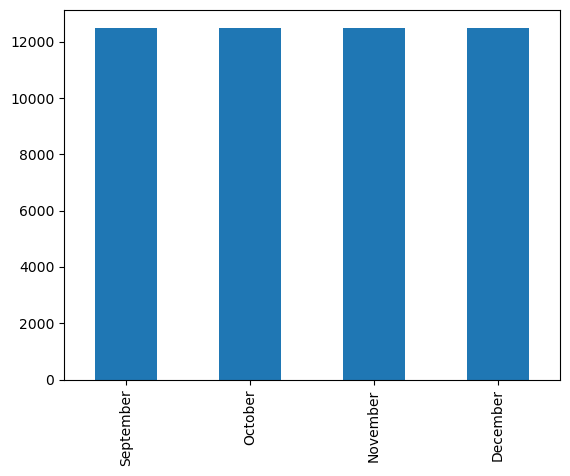

In [79]:
df['Month'].value_counts().plot(kind='bar')

In [80]:
df['Occupation'].value_counts()

Lawyer           6762
Engineer         3212
Architect        3195
Mechanic         3168
Developer        3146
Accountant       3133
Media_Manager    3130
Scientist        3104
Teacher          3103
Entrepreneur     3103
Journalist       3037
Doctor           3027
Manager          3000
Musician         2947
Writer           2933
Name: Occupation, dtype: int64

<Axes: >

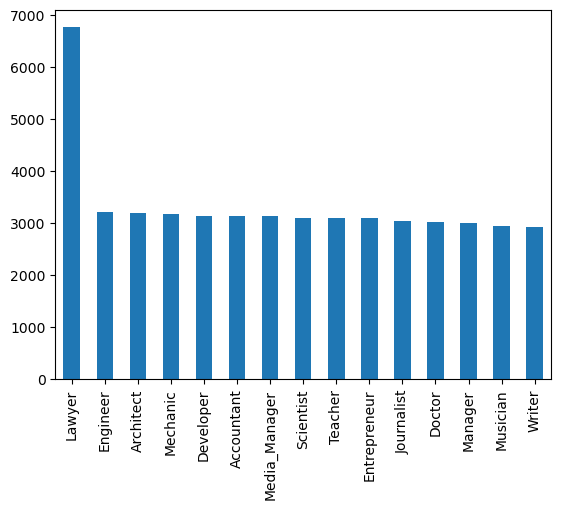

In [81]:
df['Occupation'].value_counts().plot(kind='bar')

In [82]:
df = pd.get_dummies(df, columns=['Month', 'Occupation', 'Payment_Behaviour'])
df.head(3)

,Age,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Monthly_Balance,Month_December,Month_November,Month_October,Month_September,Occupation_Accountant,Occupation_Architect,Occupation_Developer,Occupation_Doctor,Occupation_Engineer,Occupation_Entrepreneur,Occupation_Journalist,Occupation_Lawyer,Occupation_Manager,Occupation_Mechanic,Occupation_Media_Manager,Occupation_Musician,Occupation_Scientist,Occupation_Teacher,Occupation_Writer,Payment_Behaviour_!@9#%8,Payment_Behaviour_High_spent_Large_value_payments,Payment_Behaviour_High_spent_Medium_value_payments,Payment_Behaviour_High_spent_Small_value_payments,Payment_Behaviour_Low_spent_Large_value_payments,Payment_Behaviour_Low_spent_Medium_value_payments,Payment_Behaviour_Low_spent_Small_value_payments
0,23.0,19114.12,1824.843333,3.0,4.0,3.0,4.0,3.0,7.0,11.27,2022.0,1.0,809.98,35.030402,22.750000,1.0,49.574949,236.642682,186.266702,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1
1,24.0,19114.12,1824.843333,3.0,4.0,3.0,4.0,3.0,9.0,13.27,4.0,1.0,809.98,33.053114,22.833333,1.0,49.574949,21.465380,361.444004,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0
2,24.0,19114.12,1824.843333,3.0,4.0,3.0,4.0,-1.0,4.0,12.27,4.0,1.0,809.98,33.811894,18.937598,1.0,49.574949,148.233938,264.675446,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0


# **Check Outliers**

**apply Z-score for:** Normal Distribution

**apply Interquartile-rules for:** Skew Distribution

**apply Percentile-base(Winsorizing) approche for:** Others Distribution

**using domain knowledge apply:** Box-Cox Transformation and Robust Scaling and log-transformations

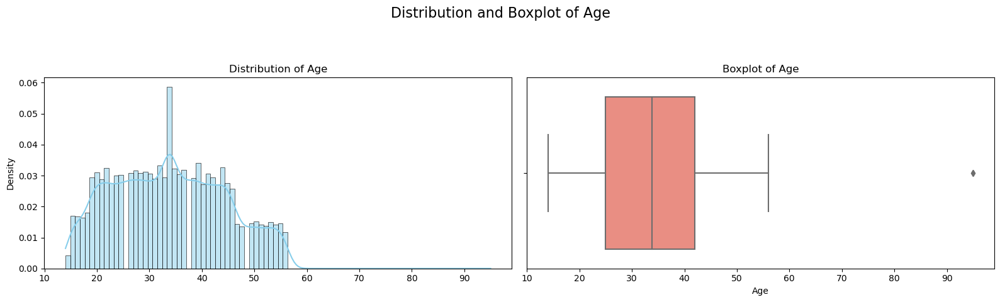

In [83]:
# Visualize 'Age'
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(16, 5))
fig.suptitle('Distribution and Boxplot of Age', fontsize=16)
sns.histplot(df['Age'], ax=axes[0], kde=True, color='skyblue', stat="density", common_norm=False)
axes[0].set_title('Distribution of Age')
axes[0].set_xlabel("")
sns.boxplot(x=df['Age'], ax=axes[1], color='salmon')
axes[1].set_title('Boxplot of Age')
plt.tight_layout(rect=[0, 0.03, 1, 0.9])
plt.show()


**Removing outliers from Age column**

In [84]:
upper_limit = df['Age'].mean() + 3 * df['Age'].std()
lower_limit = df['Age'].mean() - 3 * df['Age'].std()

#apply z-score

df['Age'] = np.where(
   df.Age > upper_limit,
   upper_limit,
   np.where(
       df.Age < lower_limit,
       lower_limit,
       df.Age
   )
)

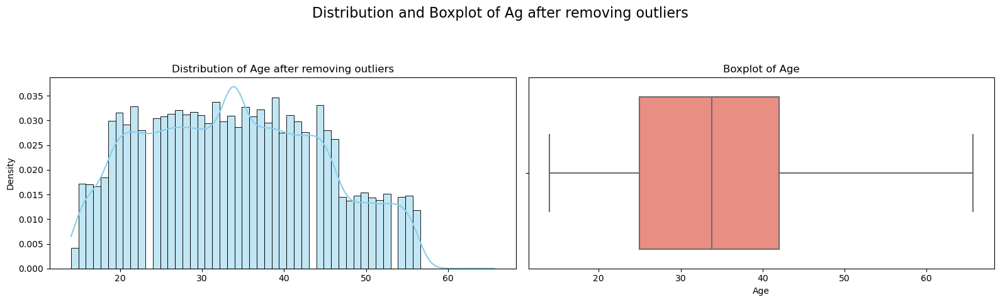

In [85]:
# Visualize 'Age'
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(16, 5))
fig.suptitle('Distribution and Boxplot of Ag after removing outliers', fontsize=16)
sns.histplot(df['Age'], ax=axes[0], kde=True, color='skyblue', stat="density", common_norm=False)
axes[0].set_title('Distribution of Age after removing outliers')
axes[0].set_xlabel("")
sns.boxplot(x=df['Age'], ax=axes[1], color='salmon')
axes[1].set_title('Boxplot of Age')
plt.tight_layout(rect=[0, 0.03, 1, 0.9])
plt.show()


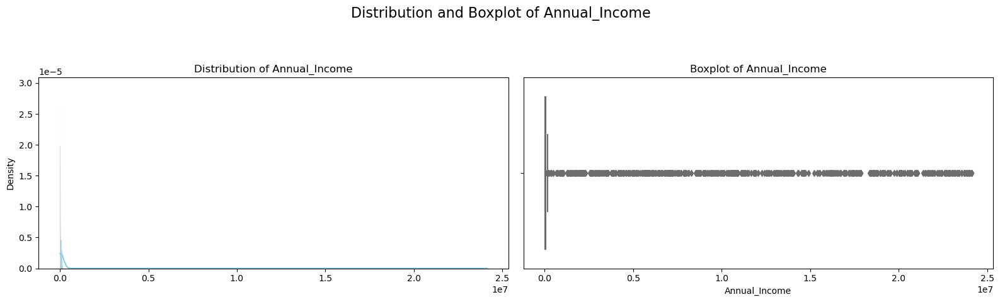

In [86]:
# Visualize 'Annual_Income'
pd.set_option('display.float_format', lambda x: '%.3f' % x)
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(16, 5))
fig.suptitle('Distribution and Boxplot of Annual_Income', fontsize=16)
sns.histplot(df['Annual_Income'], ax=axes[0], kde=True, color='skyblue', stat="density", common_norm=False)
axes[0].set_title('Distribution of Annual_Income')
axes[0].set_xlabel("")
sns.boxplot(x=df['Annual_Income'], ax=axes[1], color='salmon')
axes[1].set_title('Boxplot of Annual_Income')
plt.tight_layout(rect=[0, 0.03, 1, 0.9])
plt.show()


**Removing Outliers from Annual Income column**

In [87]:
upper_limit = df.Annual_Income.quantile(0.99)
lower_limit = df.Annual_Income.quantile(0.01)

#apply percentile

df['Annual_Income'] = np.where(
        df.Annual_Income >= upper_limit,
        upper_limit,
        np.where(df.Annual_Income <= lower_limit,
        lower_limit,
        df.Annual_Income)
        )

In [88]:
df['Annual_Income'] = np.log1p(df['Annual_Income']) #apply log-transformations

In [89]:
df.Annual_Income.describe()

count   50000.000
mean       10.556
std         0.808
min         8.927
25%         9.876
50%        10.534
75%        11.196
max        12.436
Name: Annual_Income, dtype: float64

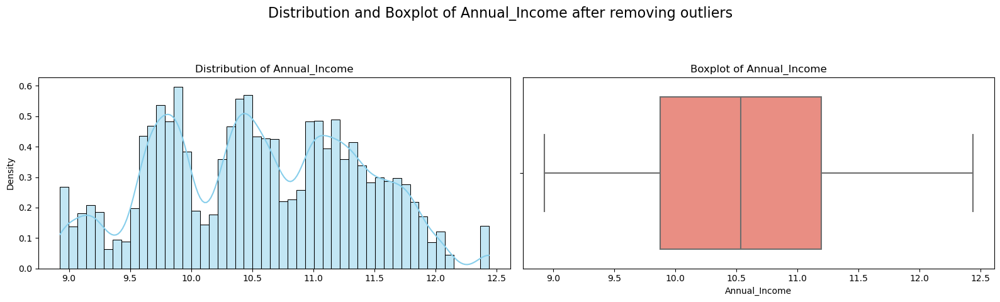

In [90]:
# Visualize 'Annual_Income'
pd.set_option('display.float_format', lambda x: '%.3f' % x)
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(16, 5))
fig.suptitle('Distribution and Boxplot of Annual_Income after removing outliers', fontsize=16)
sns.histplot(df['Annual_Income'], ax=axes[0], kde=True, color='skyblue', stat="density", common_norm=False)
axes[0].set_title('Distribution of Annual_Income')
axes[0].set_xlabel("")
sns.boxplot(x=df['Annual_Income'], ax=axes[1], color='salmon')
axes[1].set_title('Boxplot of Annual_Income')
plt.tight_layout(rect=[0, 0.03, 1, 0.9])
plt.show()


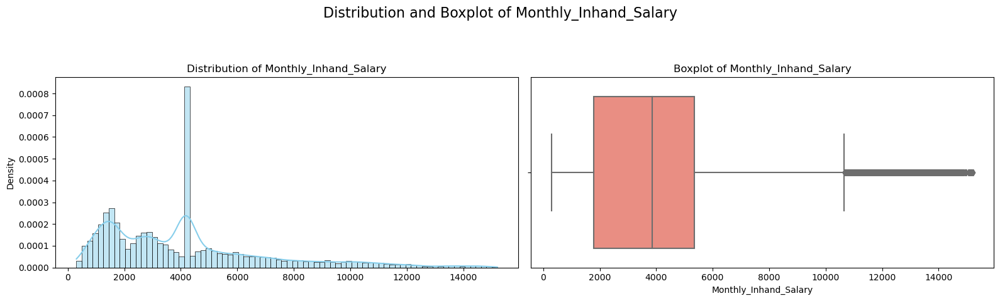

In [91]:
# Visualize 'Monthly_Inhand_Salary'
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(16, 5))
fig.suptitle('Distribution and Boxplot of Monthly_Inhand_Salary', fontsize=16)
sns.histplot(df['Monthly_Inhand_Salary'], ax=axes[0], kde=True, color='skyblue', stat="density", common_norm=False)
axes[0].set_title('Distribution of Monthly_Inhand_Salary')
axes[0].set_xlabel("")
sns.boxplot(x=df['Monthly_Inhand_Salary'], ax=axes[1], color='salmon')
axes[1].set_title('Boxplot of Monthly_Inhand_Salary')
plt.tight_layout(rect=[0, 0.03, 1, 0.9])
plt.show()


**Removing outliers from Monthly_Inhand_Salary using Interquadile**

In [92]:
percentile25 = df.Monthly_Inhand_Salary.quantile(0.25)
percentile75 = df.Monthly_Inhand_Salary.quantile(0.75)

#apply Interquartile

iqr = percentile75 - percentile25

upper_limit = percentile75 + 1.5 * iqr
lower_limit = percentile25 - 1.5 * iqr

df['Monthly_Inhand_Salary'] = np.where(
    df.Monthly_Inhand_Salary > upper_limit,
    upper_limit,
    np.where(
        df.Monthly_Inhand_Salary < lower_limit,
        lower_limit,
        df.Monthly_Inhand_Salary
    )
)

In [93]:
df.Monthly_Inhand_Salary.describe()

count   50000.000
mean     4107.302
std      2718.816
min       303.645
25%      1794.304
50%      3848.682
75%      5338.968
max     10655.963
Name: Monthly_Inhand_Salary, dtype: float64

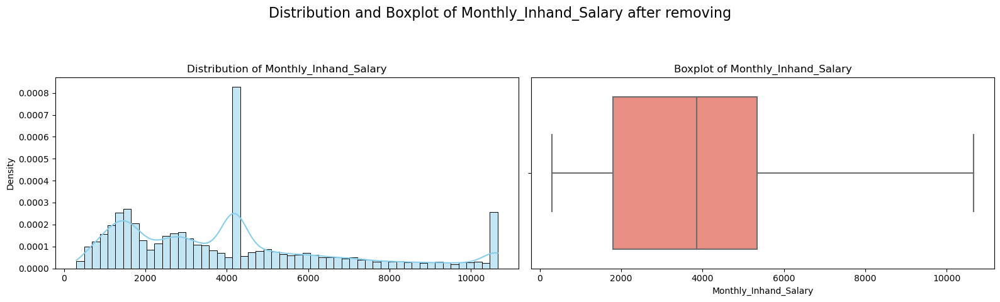

In [94]:
# Visualize 'Monthly_Inhand_Salary'
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(16, 5))
fig.suptitle('Distribution and Boxplot of Monthly_Inhand_Salary after removing', fontsize=16)
sns.histplot(df['Monthly_Inhand_Salary'], ax=axes[0], kde=True, color='skyblue', stat="density", common_norm=False)
axes[0].set_title('Distribution of Monthly_Inhand_Salary')
axes[0].set_xlabel("")
sns.boxplot(x=df['Monthly_Inhand_Salary'], ax=axes[1], color='salmon')
axes[1].set_title('Boxplot of Monthly_Inhand_Salary')
plt.tight_layout(rect=[0, 0.03, 1, 0.9])
plt.show()

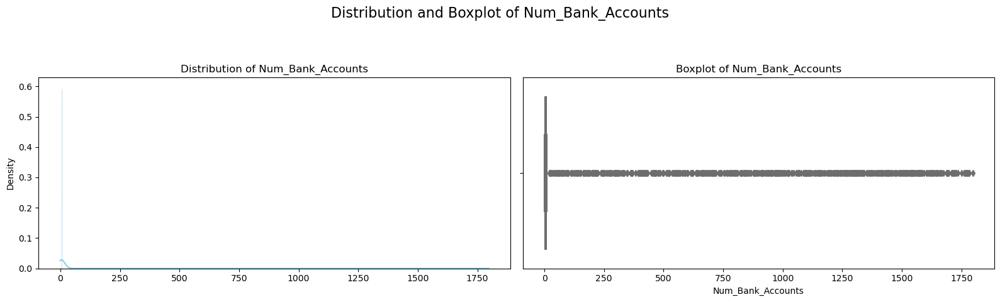

In [95]:
# Visualize 'Num_Bank_Accounts'
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(16, 5))
fig.suptitle('Distribution and Boxplot of Num_Bank_Accounts', fontsize=16)
sns.histplot(df['Num_Bank_Accounts'], ax=axes[0], kde=True, color='skyblue', stat="density", common_norm=False)
axes[0].set_title('Distribution of Num_Bank_Accounts')
axes[0].set_xlabel("")
sns.boxplot(x=df['Num_Bank_Accounts'], ax=axes[1], color='salmon')
axes[1].set_title('Boxplot of Num_Bank_Accounts')
plt.tight_layout(rect=[0, 0.03, 1, 0.9])
plt.show()


**Apply log Transformer**

In [96]:


#removing negative values
df['Num_Bank_Accounts'] = df['Num_Bank_Accounts'] + abs(df['Num_Bank_Accounts'].min()) + 1

df.Num_Bank_Accounts.describe()

count   50000.000
mean       18.838
std       116.397
min         1.000
25%         5.000
50%         8.000
75%         9.000
max      1800.000
Name: Num_Bank_Accounts, dtype: float64

In [97]:
# Apply log transformation
df['Num_Bank_Accounts'] = np.log1p(df['Num_Bank_Accounts'])

# Display summary statistics
print(df['Num_Bank_Accounts'].describe())


count   50000.000
mean        2.123
std         0.624
min         0.693
25%         1.792
50%         2.197
75%         2.303
max         7.496
Name: Num_Bank_Accounts, dtype: float64


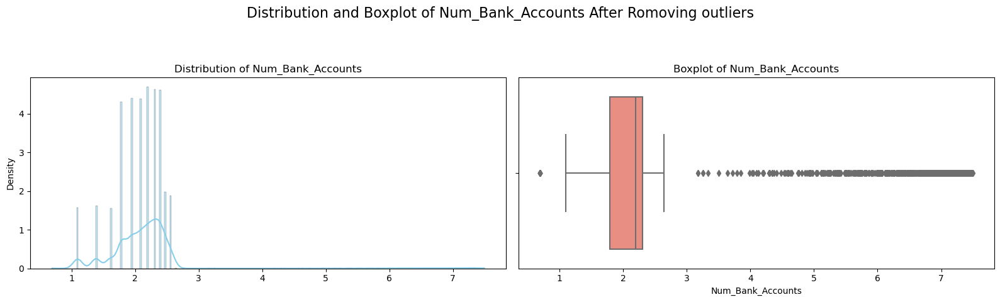

In [98]:
# Visualize 'Num_Bank_Accounts'
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(16, 5))
fig.suptitle('Distribution and Boxplot of Num_Bank_Accounts After Romoving outliers', fontsize=16)
sns.histplot(df['Num_Bank_Accounts'], ax=axes[0], kde=True, color='skyblue', stat="density", common_norm=False)
axes[0].set_title('Distribution of Num_Bank_Accounts')
axes[0].set_xlabel("")
sns.boxplot(x=df['Num_Bank_Accounts'], ax=axes[1], color='salmon')
axes[1].set_title('Boxplot of Num_Bank_Accounts')
plt.tight_layout(rect=[0, 0.03, 1, 0.9])
plt.show()

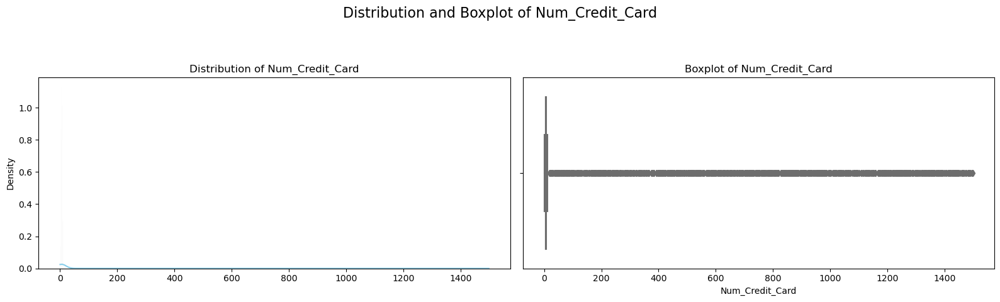

In [99]:
# Visualize 'Num_Credit_Card'
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(16, 5))
fig.suptitle('Distribution and Boxplot of Num_Credit_Card', fontsize=16)
sns.histplot(df['Num_Credit_Card'], ax=axes[0], kde=True, color='skyblue', stat="density", common_norm=False)
axes[0].set_title('Distribution of Num_Credit_Card')
axes[0].set_xlabel("")
sns.boxplot(x=df['Num_Credit_Card'], ax=axes[1], color='salmon')
axes[1].set_title('Boxplot of Num_Credit_Card')
plt.tight_layout(rect=[0, 0.03, 1, 0.9])
plt.show()


**Num_Credit_Card for this column I don't understand it's distribution that's why I'm using Box-Cox transformation**

In [100]:
#removing negative values
df['Num_Credit_Card'] = df['Num_Credit_Card'] + abs(df['Num_Credit_Card'].min()) + 1
df['Num_Bank_Accounts'] = np.log1p(df['Num_Bank_Accounts'])

df.Num_Credit_Card.describe()

count   50000.000
mean       23.921
std       129.315
min         1.000
25%         5.000
50%         6.000
75%         8.000
max      1500.000
Name: Num_Credit_Card, dtype: float64

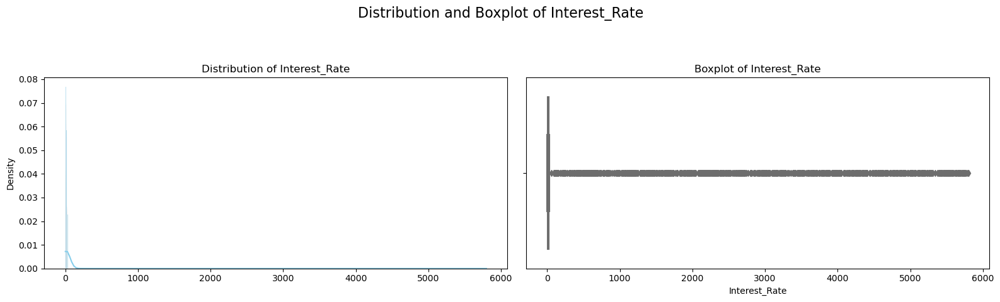

In [101]:
# Visualize 'Interest_Rate'
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(16, 5))
fig.suptitle('Distribution and Boxplot of Interest_Rate', fontsize=16)
sns.histplot(df['Interest_Rate'], ax=axes[0], kde=True, color='skyblue', stat="density", common_norm=False)
axes[0].set_title('Distribution of Interest_Rate')
axes[0].set_xlabel("")
sns.boxplot(x=df['Interest_Rate'], ax=axes[1], color='salmon')
axes[1].set_title('Boxplot of Interest_Rate')
plt.tight_layout(rect=[0, 0.03, 1, 0.9])
plt.show()


In [102]:
from scipy.stats import boxcox

transformed_data, lambda_value = boxcox(df['Interest_Rate'], lmbda=None)

df['Interest_Rate'] = np.power((transformed_data * lambda_value) + 1, 1 / lambda_value)

df.Interest_Rate.describe()

count   50000.000
mean       68.773
std       451.602
min         1.000
25%         8.000
50%        13.000
75%        20.000
max      5799.000
Name: Interest_Rate, dtype: float64

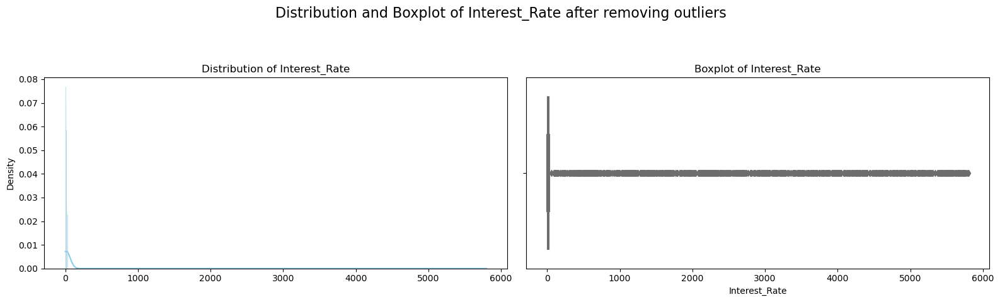

In [103]:
# Visualize 'Interest_Rate'
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(16, 5))
fig.suptitle('Distribution and Boxplot of Interest_Rate after removing outliers', fontsize=16)
sns.histplot(df['Interest_Rate'], ax=axes[0], kde=True, color='skyblue', stat="density", common_norm=False)
axes[0].set_title('Distribution of Interest_Rate')
axes[0].set_xlabel("")
sns.boxplot(x=df['Interest_Rate'], ax=axes[1], color='salmon')
axes[1].set_title('Boxplot of Interest_Rate')
plt.tight_layout(rect=[0, 0.03, 1, 0.9])
plt.show()

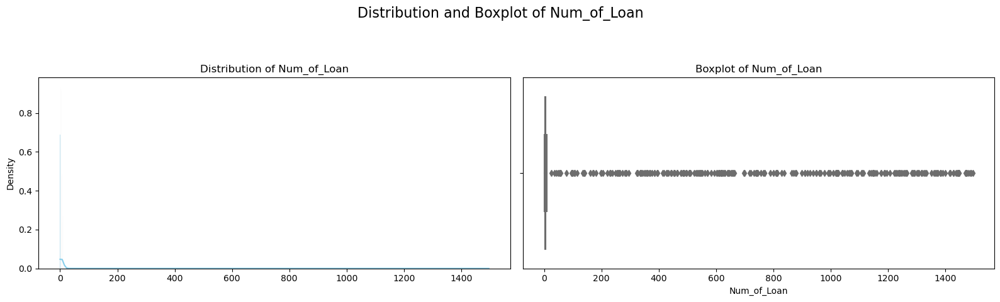

In [104]:
# Visualize 'Num_of_Loan'
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(16, 5))
fig.suptitle('Distribution and Boxplot of Num_of_Loan', fontsize=16)
sns.histplot(df['Num_of_Loan'], ax=axes[0], kde=True, color='skyblue', stat="density", common_norm=False)
axes[0].set_title('Distribution of Num_of_Loan')
axes[0].set_xlabel("")
sns.boxplot(x=df['Num_of_Loan'], ax=axes[1], color='salmon')
axes[1].set_title('Boxplot of Num_of_Loan')
plt.tight_layout(rect=[0, 0.03, 1, 0.9])
plt.show()


In [105]:
#removing negative values
df['Num_of_Loan'] = df['Num_of_Loan'] + abs(df['Num_of_Loan'].min()) + 1

df['Num_of_Loan'] = np.log1p(df['Num_of_Loan'])

df.Num_of_Loan.describe()

count   50000.000
mean        1.640
std         0.594
min         0.693
25%         1.386
50%         1.609
75%         1.946
max         7.312
Name: Num_of_Loan, dtype: float64

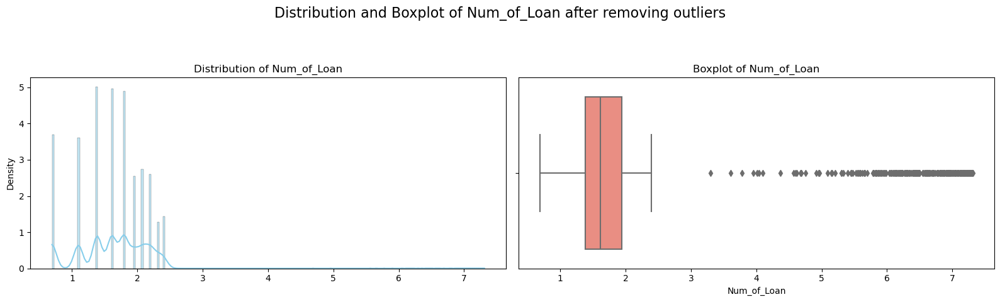

In [106]:
# Visualize 'Num_of_Loan'
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(16, 5))
fig.suptitle('Distribution and Boxplot of Num_of_Loan after removing outliers', fontsize=16)
sns.histplot(df['Num_of_Loan'], ax=axes[0], kde=True, color='skyblue', stat="density", common_norm=False)
axes[0].set_title('Distribution of Num_of_Loan')
axes[0].set_xlabel("")
sns.boxplot(x=df['Num_of_Loan'], ax=axes[1], color='salmon')
axes[1].set_title('Boxplot of Num_of_Loan')
plt.tight_layout(rect=[0, 0.03, 1, 0.9])
plt.show()

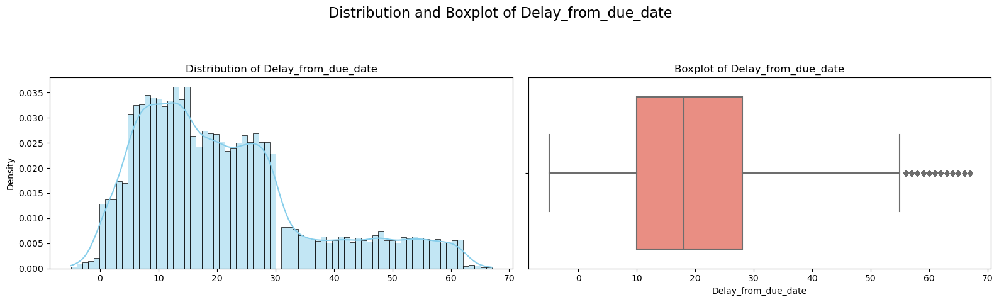

In [107]:
# Visualize 'Delay_from_due_date'
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(16, 5))
fig.suptitle('Distribution and Boxplot of Delay_from_due_date', fontsize=16)
sns.histplot(df['Delay_from_due_date'], ax=axes[0], kde=True, color='skyblue', stat="density", common_norm=False)
axes[0].set_title('Distribution of Delay_from_due_date')
axes[0].set_xlabel("")
sns.boxplot(x=df['Delay_from_due_date'], ax=axes[1], color='salmon')
axes[1].set_title('Boxplot of Delay_from_due_date')
plt.tight_layout(rect=[0, 0.03, 1, 0.9])
plt.show()


**Removing outliers from Delay_from_due_date column**

In [108]:
percentile25 = df.Delay_from_due_date.quantile(0.25)
percentile75 = df.Delay_from_due_date.quantile(0.75)

iqr = percentile75 - percentile25

upper_limit = percentile75 + 1.5 * iqr
lower_limit = percentile25 - 1.5 * iqr

df['Delay_from_due_date'] = np.where(
    df.Delay_from_due_date > upper_limit,
    upper_limit,
    np.where(
        df.Delay_from_due_date < lower_limit,
        lower_limit,
        df.Delay_from_due_date
    )
)

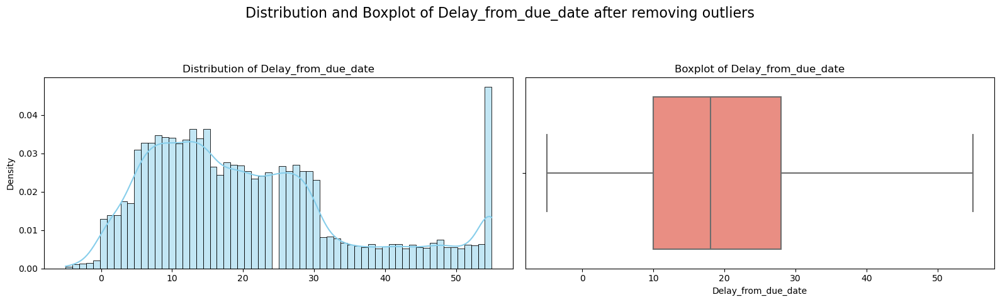

In [109]:
# Visualize 'Delay_from_due_date'
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(16, 5))
fig.suptitle('Distribution and Boxplot of Delay_from_due_date after removing outliers', fontsize=16)
sns.histplot(df['Delay_from_due_date'], ax=axes[0], kde=True, color='skyblue', stat="density", common_norm=False)
axes[0].set_title('Distribution of Delay_from_due_date')
axes[0].set_xlabel("")
sns.boxplot(x=df['Delay_from_due_date'], ax=axes[1], color='salmon')
axes[1].set_title('Boxplot of Delay_from_due_date')
plt.tight_layout(rect=[0, 0.03, 1, 0.9])
plt.show()


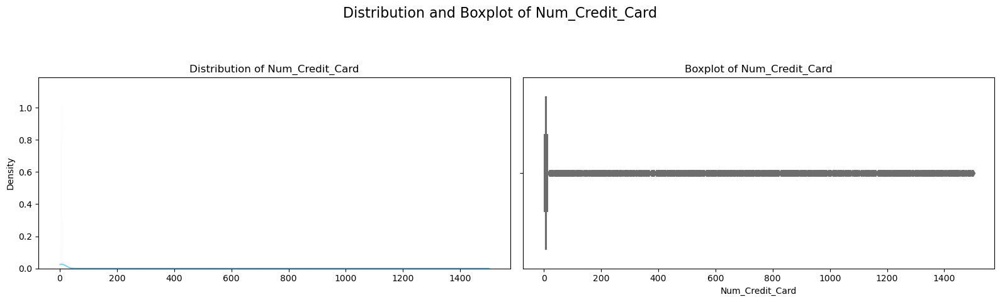

In [110]:
# Visualize 'Num_Credit_Card'
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(16, 5))
fig.suptitle('Distribution and Boxplot of Num_Credit_Card', fontsize=16)
sns.histplot(df['Num_Credit_Card'], ax=axes[0], kde=True, color='skyblue', stat="density", common_norm=False)
axes[0].set_title('Distribution of Num_Credit_Card')
axes[0].set_xlabel("")
sns.boxplot(x=df['Num_Credit_Card'], ax=axes[1], color='salmon')
axes[1].set_title('Boxplot of Num_Credit_Card')
plt.tight_layout(rect=[0, 0.03, 1, 0.9])
plt.show()


In [111]:
df['Num_Credit_Card'] = np.log1p(df['Num_Credit_Card'])

df.Num_Credit_Card.describe()

count   50000.000
mean        2.082
std         0.735
min         0.693
25%         1.792
50%         1.946
75%         2.197
max         7.314
Name: Num_Credit_Card, dtype: float64

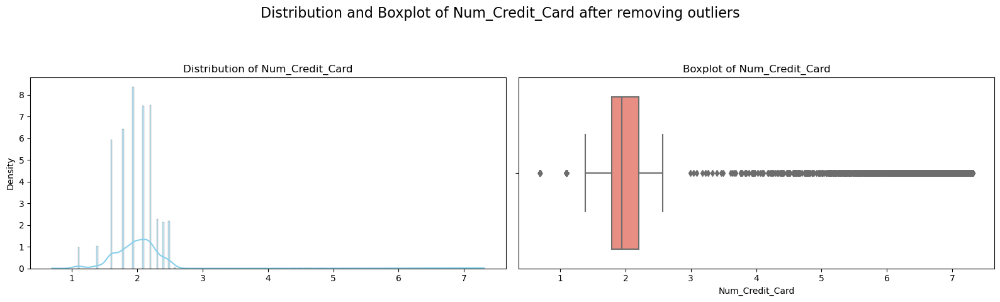

In [112]:
# Visualize 'Num_Credit_Card'
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(16, 5))
fig.suptitle('Distribution and Boxplot of Num_Credit_Card after removing outliers', fontsize=16)
sns.histplot(df['Num_Credit_Card'], ax=axes[0], kde=True, color='skyblue', stat="density", common_norm=False)
axes[0].set_title('Distribution of Num_Credit_Card')
axes[0].set_xlabel("")
sns.boxplot(x=df['Num_Credit_Card'], ax=axes[1], color='salmon')
axes[1].set_title('Boxplot of Num_Credit_Card')
plt.tight_layout(rect=[0, 0.03, 1, 0.9])
plt.show()


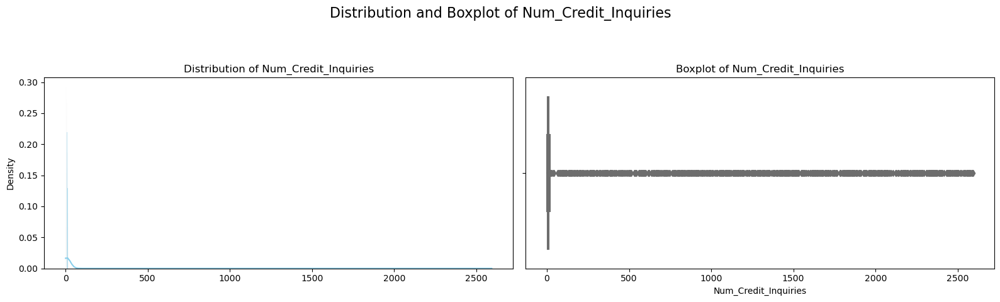

In [113]:
# Visualize 'Num_Credit_Inquiries'
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(16, 5))
fig.suptitle('Distribution and Boxplot of Num_Credit_Inquiries', fontsize=16)
sns.histplot(df['Num_Credit_Inquiries'], ax=axes[0], kde=True, color='skyblue', stat="density", common_norm=False)
axes[0].set_title('Distribution of Num_Credit_Inquiries')
axes[0].set_xlabel("")
sns.boxplot(x=df['Num_Credit_Inquiries'], ax=axes[1], color='salmon')
axes[1].set_title('Boxplot of Num_Credit_Inquiries')
plt.tight_layout(rect=[0, 0.03, 1, 0.9])
plt.show()


In [114]:
from scipy.stats import boxcox

#removing negative values
df['Num_Credit_Inquiries'] = df['Num_Credit_Inquiries'] + abs(df['Num_Credit_Inquiries'].min()) + 1

transformed_data, lambda_value = boxcox(df['Num_Credit_Inquiries'], lmbda=None)

df['Num_Credit_Inquiries'] = np.power((transformed_data * lambda_value) + 1, 1 / lambda_value)


df.Num_Credit_Inquiries.describe()

count   50000.000
mean       30.671
std       194.957
min         1.000
25%         5.000
50%         8.000
75%        11.000
max      2594.000
Name: Num_Credit_Inquiries, dtype: float64

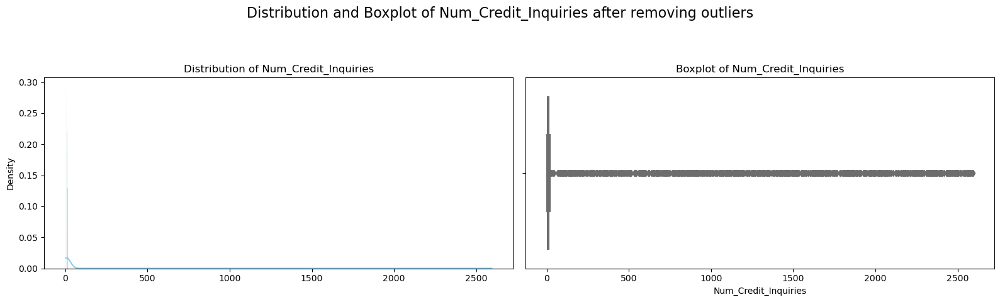

In [115]:
# Visualize 'Num_Credit_Inquiries'
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(16, 5))
fig.suptitle('Distribution and Boxplot of Num_Credit_Inquiries after removing outliers', fontsize=16)
sns.histplot(df['Num_Credit_Inquiries'], ax=axes[0], kde=True, color='skyblue', stat="density", common_norm=False)
axes[0].set_title('Distribution of Num_Credit_Inquiries')
axes[0].set_xlabel("")
sns.boxplot(x=df['Num_Credit_Inquiries'], ax=axes[1], color='salmon')
axes[1].set_title('Boxplot of Num_Credit_Inquiries')
plt.tight_layout(rect=[0, 0.03, 1, 0.9])
plt.show()


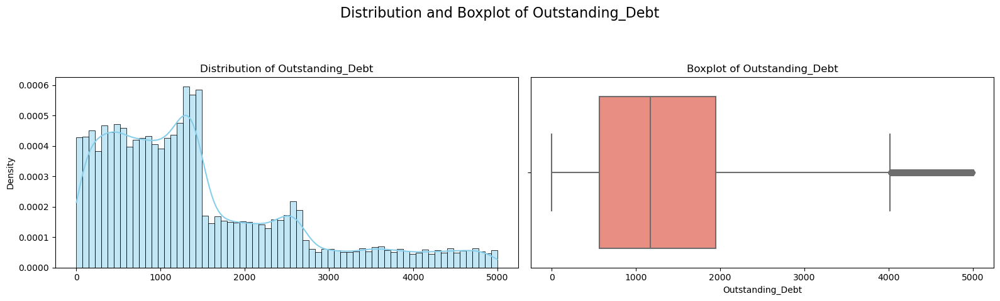

In [116]:
# Visualize 'Outstanding_Debt'
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(16, 5))
fig.suptitle('Distribution and Boxplot of Outstanding_Debt', fontsize=16)
sns.histplot(df['Outstanding_Debt'], ax=axes[0], kde=True, color='skyblue', stat="density", common_norm=False)
axes[0].set_title('Distribution of Outstanding_Debt')
axes[0].set_xlabel("")
sns.boxplot(x=df['Outstanding_Debt'], ax=axes[1], color='salmon')
axes[1].set_title('Boxplot of Outstanding_Debt')
plt.tight_layout(rect=[0, 0.03, 1, 0.9])
plt.show()

**Removing outliers from Outstanding_Debt column**

In [117]:
percentile25 = df.Outstanding_Debt.quantile(0.25)
percentile75 = df.Outstanding_Debt.quantile(0.75)

iqr = percentile75 - percentile25

upper_limit = percentile75 + 1.5 * iqr
lower_limit = percentile25 - 1.5 * iqr

df['Delay_from_due_date'] = np.where(
    df.Outstanding_Debt > upper_limit,
    upper_limit,
    np.where(
        df.Outstanding_Debt < lower_limit,
        lower_limit,
        df.Outstanding_Debt
    )
)

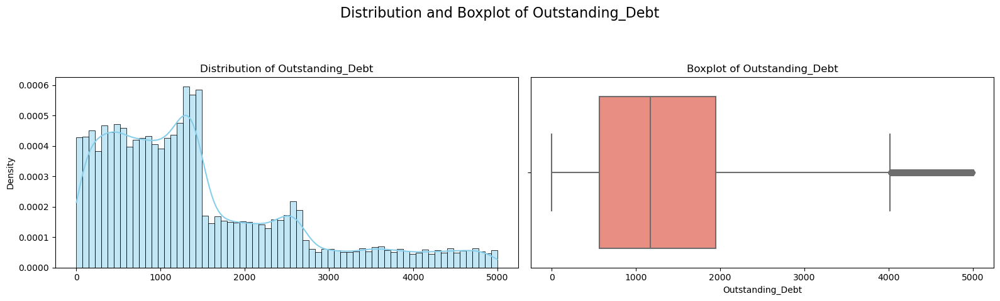

In [118]:
# Visualize 'Outstanding_Debt'
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(16, 5))
fig.suptitle('Distribution and Boxplot of Outstanding_Debt', fontsize=16)
sns.histplot(df['Outstanding_Debt'], ax=axes[0], kde=True, color='skyblue', stat="density", common_norm=False)
axes[0].set_title('Distribution of Outstanding_Debt')
axes[0].set_xlabel("")
sns.boxplot(x=df['Outstanding_Debt'], ax=axes[1], color='salmon')
axes[1].set_title('Boxplot of Outstanding_Debt')
plt.tight_layout(rect=[0, 0.03, 1, 0.9])
plt.show()

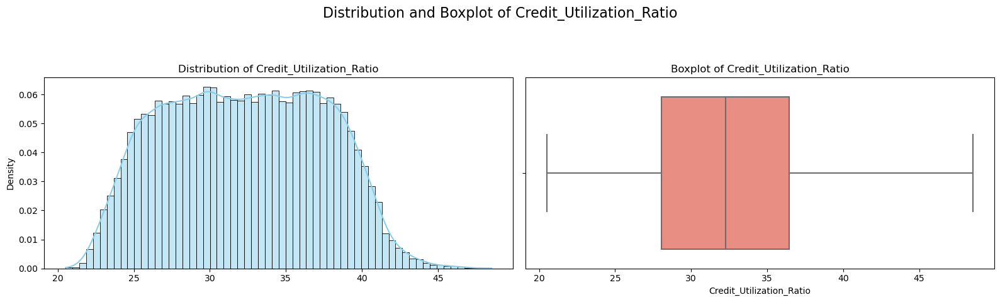

In [119]:
# Visualize 'Credit_Utilization_Ratio'
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(16, 5))
fig.suptitle('Distribution and Boxplot of Credit_Utilization_Ratio', fontsize=16)
sns.histplot(df['Credit_Utilization_Ratio'], ax=axes[0], kde=True, color='skyblue', stat="density", common_norm=False)
axes[0].set_title('Distribution of Credit_Utilization_Ratio')
axes[0].set_xlabel("")
sns.boxplot(x=df['Credit_Utilization_Ratio'], ax=axes[1], color='salmon')
axes[1].set_title('Boxplot of Credit_Utilization_Ratio')
plt.tight_layout(rect=[0, 0.03, 1, 0.9])
plt.show()

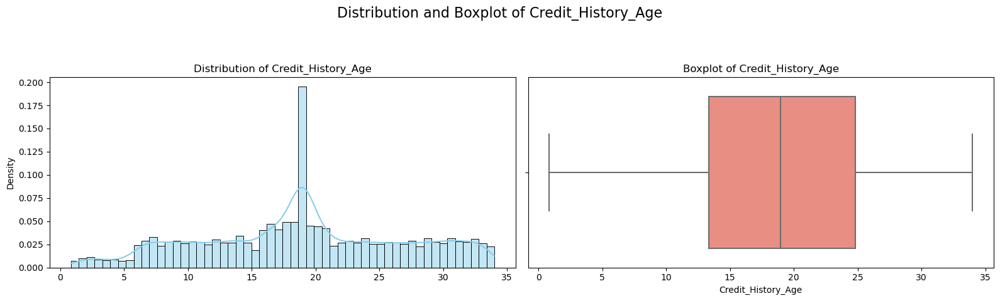

In [120]:
# Visualize 'Credit_History_Age'
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(16, 5))
fig.suptitle('Distribution and Boxplot of Credit_History_Age', fontsize=16)
sns.histplot(df['Credit_History_Age'], ax=axes[0], kde=True, color='skyblue', stat="density", common_norm=False)
axes[0].set_title('Distribution of Credit_History_Age')
axes[0].set_xlabel("")
sns.boxplot(x=df['Credit_History_Age'], ax=axes[1], color='salmon')
axes[1].set_title('Boxplot of Credit_History_Age')
plt.tight_layout(rect=[0, 0.03, 1, 0.9])
plt.show()

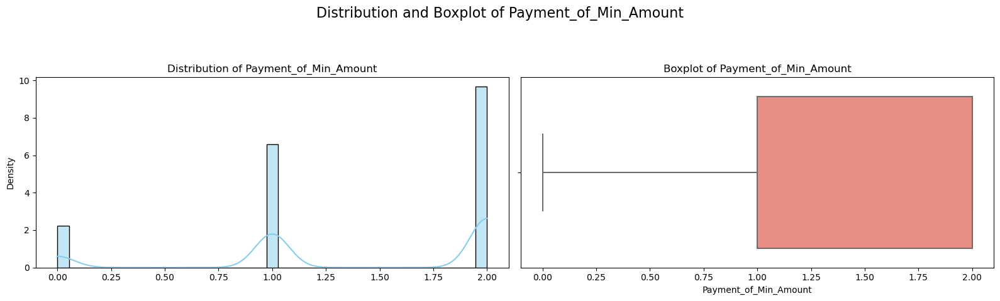

In [121]:
# Visualize 'Payment_of_Min_Amount'
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(16, 5))
fig.suptitle('Distribution and Boxplot of Payment_of_Min_Amount', fontsize=16)
sns.histplot(df['Payment_of_Min_Amount'], ax=axes[0], kde=True, color='skyblue', stat="density", common_norm=False)
axes[0].set_title('Distribution of Payment_of_Min_Amount')
axes[0].set_xlabel("")
sns.boxplot(x=df['Payment_of_Min_Amount'], ax=axes[1], color='salmon')
axes[1].set_title('Boxplot of Payment_of_Min_Amount')
plt.tight_layout(rect=[0, 0.03, 1, 0.9])
plt.show()

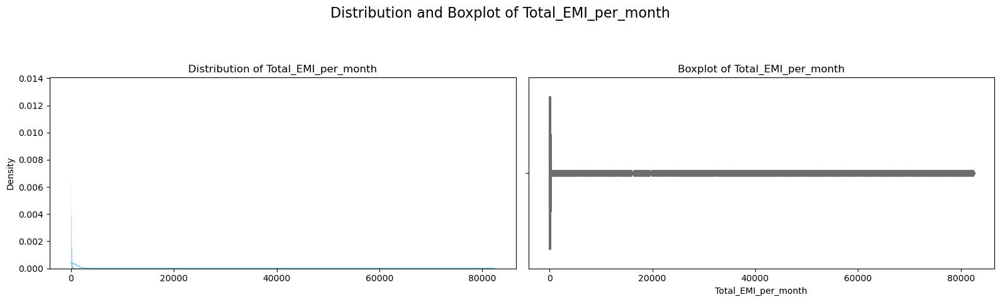

In [122]:
# Visualize 'Total_EMI_per_month'
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(16, 5))
fig.suptitle('Distribution and Boxplot of Total_EMI_per_month', fontsize=16)
sns.histplot(df['Total_EMI_per_month'], ax=axes[0], kde=True, color='skyblue', stat="density", common_norm=False)
axes[0].set_title('Distribution of Total_EMI_per_month')
axes[0].set_xlabel("")
sns.boxplot(x=df['Total_EMI_per_month'], ax=axes[1], color='salmon')
axes[1].set_title('Boxplot of Total_EMI_per_month')
plt.tight_layout(rect=[0, 0.03, 1, 0.9])
plt.show()

In [123]:
df['Total_EMI_per_month'] = np.log1p(df['Total_EMI_per_month'])

df.Total_EMI_per_month.describe()

count   50000.000
mean        4.207
std         1.980
min         0.000
25%         3.503
50%         4.327
75%         5.177
max        11.319
Name: Total_EMI_per_month, dtype: float64

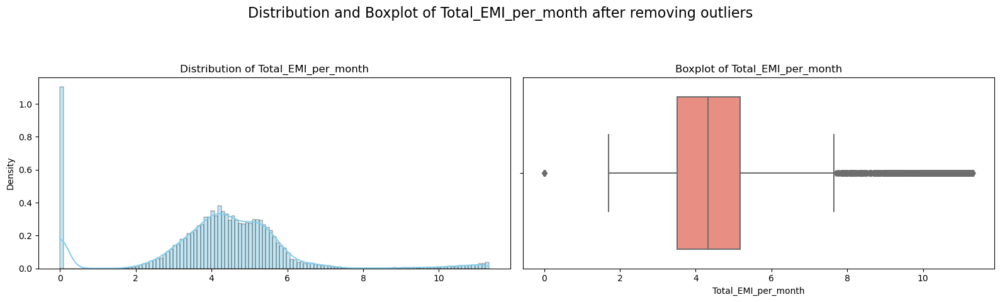

In [124]:
# Visualize 'Total_EMI_per_month'
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(16, 5))
fig.suptitle('Distribution and Boxplot of Total_EMI_per_month after removing outliers', fontsize=16)
sns.histplot(df['Total_EMI_per_month'], ax=axes[0], kde=True, color='skyblue', stat="density", common_norm=False)
axes[0].set_title('Distribution of Total_EMI_per_month')
axes[0].set_xlabel("")
sns.boxplot(x=df['Total_EMI_per_month'], ax=axes[1], color='salmon')
axes[1].set_title('Boxplot of Total_EMI_per_month')
plt.tight_layout(rect=[0, 0.03, 1, 0.9])
plt.show()

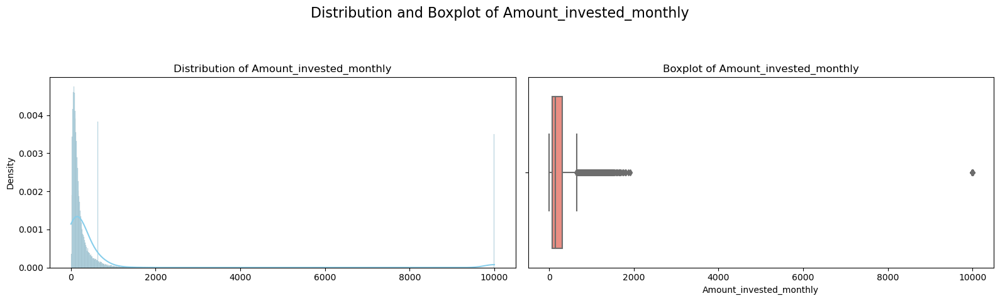

In [125]:
# Visualize 'Amount_invested_monthly'
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(16, 5))
fig.suptitle('Distribution and Boxplot of Amount_invested_monthly', fontsize=16)
sns.histplot(df['Amount_invested_monthly'], ax=axes[0], kde=True, color='skyblue', stat="density", common_norm=False)
axes[0].set_title('Distribution of Amount_invested_monthly')
axes[0].set_xlabel("")
sns.boxplot(x=df['Amount_invested_monthly'], ax=axes[1], color='salmon')
axes[1].set_title('Boxplot of Amount_invested_monthly')
plt.tight_layout(rect=[0, 0.03, 1, 0.9])
plt.show()

In [126]:
percentile25 = df.Amount_invested_monthly.quantile(0.25)
percentile75 = df.Amount_invested_monthly.quantile(0.75)

iqr = percentile75 - percentile25

upper_limit = percentile75 + 1.5 * iqr
lower_limit = percentile25 - 1.5 * iqr

df['Amount_invested_monthly'] = np.where(
    df.Amount_invested_monthly > upper_limit,
    upper_limit,
    np.where(
        df.Amount_invested_monthly < lower_limit,
        lower_limit,
        df.Amount_invested_monthly
    )
)

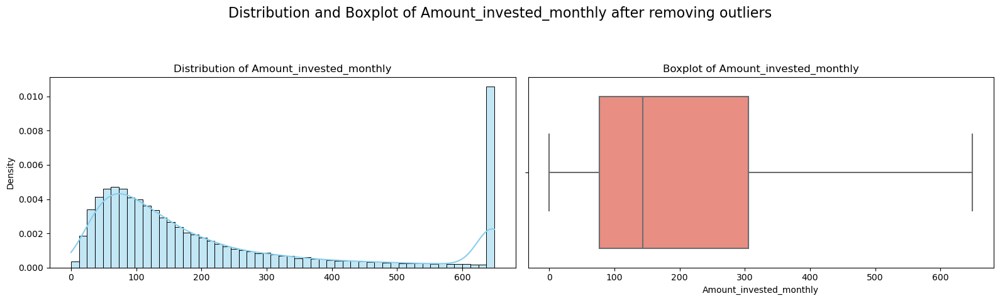

In [127]:
# Visualize 'Amount_invested_monthly'
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(16, 5))
fig.suptitle('Distribution and Boxplot of Amount_invested_monthly after removing outliers', fontsize=16)
sns.histplot(df['Amount_invested_monthly'], ax=axes[0], kde=True, color='skyblue', stat="density", common_norm=False)
axes[0].set_title('Distribution of Amount_invested_monthly')
axes[0].set_xlabel("")
sns.boxplot(x=df['Amount_invested_monthly'], ax=axes[1], color='salmon')
axes[1].set_title('Boxplot of Amount_invested_monthly')
plt.tight_layout(rect=[0, 0.03, 1, 0.9])
plt.show()

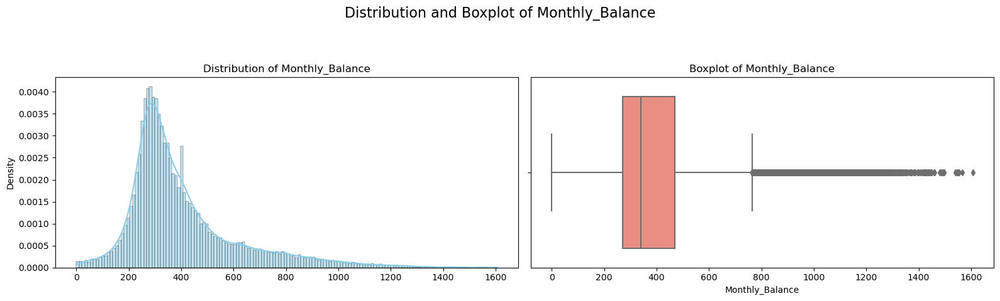

In [128]:
# Visualize 'Monthly_Balance'
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(16, 5))
fig.suptitle('Distribution and Boxplot of Monthly_Balance', fontsize=16)
sns.histplot(df['Monthly_Balance'], ax=axes[0], kde=True, color='skyblue', stat="density", common_norm=False)
axes[0].set_title('Distribution of Monthly_Balance')
axes[0].set_xlabel("")
sns.boxplot(x=df['Monthly_Balance'], ax=axes[1], color='salmon')
axes[1].set_title('Boxplot of Monthly_Balance')
plt.tight_layout(rect=[0, 0.03, 1, 0.9])
plt.show()

In [129]:
percentile25 = df.Monthly_Balance.quantile(0.25)
percentile75 = df.Monthly_Balance.quantile(0.75)

iqr = percentile75 - percentile25

upper_limit = percentile75 + 1.5 * iqr
lower_limit = percentile25 - 1.5 * iqr

df['Monthly_Balance'] = np.where(
    df.Monthly_Balance > upper_limit,
    upper_limit,
    np.where(
        df.Monthly_Balance < lower_limit,
        lower_limit,
        df.Monthly_Balance
    )
)

df.Monthly_Balance.describe()

count   50000.000
mean      388.694
std       173.506
min         0.103
25%       271.119
50%       338.992
75%       468.571
max       764.750
Name: Monthly_Balance, dtype: float64

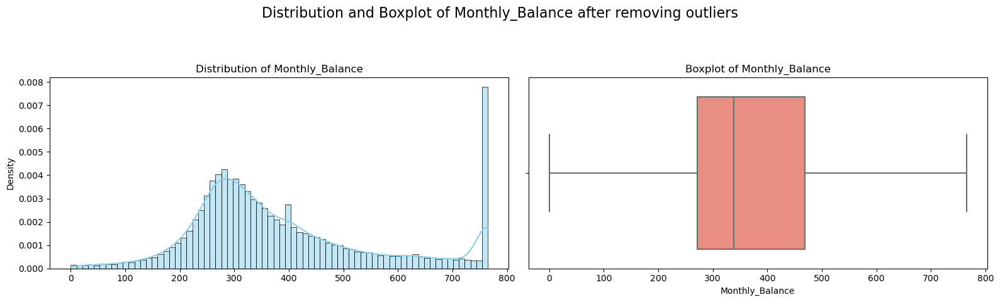

In [130]:
# Visualize 'Monthly_Balance'
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(16, 5))
fig.suptitle('Distribution and Boxplot of Monthly_Balance after removing outliers', fontsize=16)
sns.histplot(df['Monthly_Balance'], ax=axes[0], kde=True, color='skyblue', stat="density", common_norm=False)
axes[0].set_title('Distribution of Monthly_Balance')
axes[0].set_xlabel("")
sns.boxplot(x=df['Monthly_Balance'], ax=axes[1], color='salmon')
axes[1].set_title('Boxplot of Monthly_Balance')
plt.tight_layout(rect=[0, 0.03, 1, 0.9])
plt.show()

# **Choosing Target Variable**

"Monthly Balance" can have different meanings depending on the context, but here are the two most likely interpretations:

**1. Financial Account Balance:** This is the most common meaning. It refers to the amount of money remaining in your bank account at the end of each month. This applies to checking accounts, savings accounts, credit card accounts, or any other type of financial account.

**2. Budget Tracking:** In budgeting, "Monthly Balance" refers to the money left after paying all your bills and expenses for the month. This helps track progress towards financial goals like saving for a house or paying off debt.

In [131]:
X = df.drop('Credit_Mix', axis=1)
y = df['Credit_Mix']

In [132]:
y.value_counts()

2.000    18379
1.000    12260
3.000     9805
0.000     9556
Name: Credit_Mix, dtype: int64

# **Imbalanced data Handle**

In [133]:
standard = (18379/(18379+12260+9805+9556)) *100
good = (12260/(18379+12260+9805+9556)) *100
neutral = (9805/(18379+12260+9805+9556)) *100
bad = (9556/(18379+12260+9805+9556)) *100

print('Standard {} percent of total Credit Mix'.format(standard))
print('Good {} percent of total Credit Mix'.format(good))
print('Neutral {} percent of total Credit Mix'.format(neutral))
print('Bad {} percent of total Credit Mix'.format(bad))

Standard 36.758 percent of total Credit Mix
Good 24.52 percent of total Credit Mix
Neutral 19.61 percent of total Credit Mix
Bad 19.112000000000002 percent of total Credit Mix


In [134]:
from imblearn.over_sampling import RandomOverSampler

over = RandomOverSampler(random_state=100)

X_new , y_new = over.fit_resample(X,y)

X_new.shape, y_new.shape

((73516, 44), (73516,))

In [135]:
y_new.value_counts()

1.000    18379
3.000    18379
2.000    18379
0.000    18379
Name: Credit_Mix, dtype: int64

In [136]:
X_new.head()

,Age,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,Num_Credit_Inquiries,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Monthly_Balance,Month_December,Month_November,Month_October,Month_September,Occupation_Accountant,Occupation_Architect,Occupation_Developer,Occupation_Doctor,Occupation_Engineer,Occupation_Entrepreneur,Occupation_Journalist,Occupation_Lawyer,Occupation_Manager,Occupation_Mechanic,Occupation_Media_Manager,Occupation_Musician,Occupation_Scientist,Occupation_Teacher,Occupation_Writer,Payment_Behaviour_!@9#%8,Payment_Behaviour_High_spent_Large_value_payments,Payment_Behaviour_High_spent_Medium_value_payments,Payment_Behaviour_High_spent_Small_value_payments,Payment_Behaviour_Low_spent_Large_value_payments,Payment_Behaviour_Low_spent_Medium_value_payments,Payment_Behaviour_Low_spent_Small_value_payments
0,23.000,9.858,1824.843,1.027,1.792,3.000,1.792,809.980,7.000,11.270,2023.000,809.980,35.030,22.750,1.000,3.923,236.643,186.267,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1
1,24.000,9.858,1824.843,1.027,1.792,3.000,1.792,809.980,9.000,13.270,5.000,809.980,33.053,22.833,1.000,3.923,21.465,361.444,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0
2,24.000,9.858,1824.843,1.027,1.792,3.000,1.792,809.980,4.000,12.270,5.000,809.980,33.812,18.938,1.000,3.923,148.234,264.675,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0
3,24.000,9.858,4182.004,1.027,1.792,3.000,1.792,809.980,5.000,11.270,5.000,809.980,32.431,23.000,1.000,3.923,39.083,343.827,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0
4,28.000,10.459,3037.987,0.959,1.792,6.000,1.099,605.030,1.000,5.420,6.000,605.030,25.927,27.250,1.000,2.987,39.684,485.298,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0


**Apply MinMax() for Numberical Columns then apply PCA**

**Split Dataset**

In [138]:
from sklearn.model_selection import train_test_split


X_train, X_test, y_train, y_test = train_test_split(X_new, y_new, test_size=0.2, random_state=42)


X_train.shape, X_test.shape, y_train.shape, y_test.shape


((58812, 44), (14704, 44), (58812,), (14704,))

**Apply MinMax**

In [139]:
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler


scaler = StandardScaler()

X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

X_train_scaled_df = pd.DataFrame(X_train_scaled)
X_test_scaled_df = pd.DataFrame(X_test_scaled)


In [140]:
X_train_scaled_df.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43
0,0.411,0.976,1.003,0.413,0.140,-0.091,-0.102,-0.137,-0.092,-0.371,-0.081,-0.156,-0.693,-1.227,0.861,0.435,-0.864,1.867,-0.576,-0.579,-0.580,1.741,-0.256,-0.259,-0.260,-0.252,-0.266,-0.259,-0.252,-0.397,-0.253,-0.261,-0.257,-0.250,-0.258,-0.256,3.977,-0.286,2.512,-0.465,-0.356,-0.341,-0.401,-0.585
1,0.221,-0.993,-0.956,-0.012,-0.416,-0.113,-1.648,-1.090,-0.102,0.691,-0.107,-1.047,-1.025,0.821,-2.025,-0.222,-0.453,-0.711,1.736,-0.579,-0.580,-0.574,-0.256,-0.259,-0.260,-0.252,-0.266,-0.259,-0.252,2.521,-0.253,-0.261,-0.257,-0.250,-0.258,-0.256,-0.251,-0.286,-0.398,-0.465,-0.356,-0.341,-0.401,1.710
2,2.115,-1.396,0.044,-0.012,-0.665,-0.131,-0.964,-0.443,-0.057,-1.226,-0.142,-0.442,-0.538,0.656,-0.582,-1.097,-0.847,-0.202,1.736,-0.579,-0.580,-0.574,-0.256,-0.259,-0.260,3.975,-0.266,-0.259,-0.252,-0.397,-0.253,-0.261,-0.257,-0.250,-0.258,-0.256,-0.251,-0.286,-0.398,-0.465,-0.356,-0.341,-0.401,1.710
3,0.032,0.978,1.067,0.216,0.414,-0.093,1.067,2.153,-0.052,2.496,-0.101,2.398,0.234,-0.898,0.861,0.849,-0.667,0.631,-0.576,1.728,-0.580,-0.574,-0.256,-0.259,-0.260,-0.252,-0.266,-0.259,-0.252,2.521,-0.253,-0.261,-0.257,-0.250,-0.258,-0.256,-0.251,-0.286,-0.398,2.151,-0.356,-0.341,-0.401,-0.585
4,1.737,-0.158,-0.370,-0.281,0.140,-0.147,-1.648,-1.259,-0.131,-0.495,-0.142,-1.205,0.953,-0.064,-0.582,-2.181,-0.611,0.415,-0.576,-0.579,1.723,-0.574,-0.256,-0.259,-0.260,-0.252,-0.266,-0.259,-0.252,-0.397,-0.253,-0.261,-0.257,3.995,-0.258,-0.256,-0.251,-0.286,-0.398,2.151,-0.356,-0.341,-0.401,-0.585


In [141]:
X_train_scaled_df.shape, X_test_scaled_df.shape

((58812, 44), (14704, 44))

**Apply PCA**

In [142]:
from sklearn.decomposition import PCA

pca = PCA(n_components=3)  # Adjust the number of components as needed

X_train_pca = pca.fit_transform(X_train_scaled_df)
X_test_pca = pca.transform(X_test_scaled_df)

X_train_pca_df = pd.DataFrame(X_train_pca, columns=[f'pca_{i+1}' for i in range(3)])
X_test_pca_df = pd.DataFrame(X_test_pca, columns=[f'pca_{i+1}' for i in range(3)])


In [143]:
X_train_pca_df.head()

,pca_1,pca_2,pca_3
0,-0.831,2.165,-1.516
1,-0.746,-3.108,0.234
2,-0.829,-2.938,-0.213
3,2.405,3.582,-1.139
4,-2.230,-1.678,-2.032


In [144]:
X_test_pca_df.head()

,pca_1,pca_2,pca_3
0,3.237,-1.626,-0.746
1,4.128,-0.517,-0.595
2,-0.604,-0.868,-1.385
3,1.594,0.942,-1.420
4,2.697,-0.369,1.007


In [145]:
X_train_pca_df.shape

(58812, 3)

In [146]:
import plotly.express as px

fig = px.scatter_3d(X_train_pca_df, x='pca_1', y='pca_2', z='pca_3', color=y_train)

fig.update_layout(scene=dict(
                    xaxis_title='PC1',
                    yaxis_title='PC2',
                    zaxis_title='PC3'),
                    title='3D Visualization of Training Data after PCA')

fig.show()


In [147]:
import plotly.express as px

fig = px.scatter_3d(X_test_pca_df, x='pca_1', y='pca_2', z='pca_3', color=y_test)

fig.update_layout(
    scene=dict(
        xaxis_title='PC1',
        yaxis_title='PC2',
        zaxis_title='PC3'
    ),
    title='3D Visualization of Test Data after PCA'
)

fig.show()


# **3. Model Selection:**

**Logistic Regression**

In [148]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix


# Initialize logistic regression model
logreg = LogisticRegression(random_state=42)

# Fit the model on the training data
logreg.fit(X_train_pca_df, y_train)

# Make predictions on the testing data
y_pred = logreg.predict(X_test_pca_df)

# Evaluate the model
accuracy = accuracy_score(y_test, y_pred)
precision = precision_score(y_test, y_pred, average='weighted')
recall = recall_score(y_test, y_pred, average='weighted')
f1 = f1_score(y_test, y_pred, average='weighted')
conf_matrix = confusion_matrix(y_test, y_pred)

print(f"Accuracy: {accuracy:.4f}")
print(f"Precision: {precision:.4f}")
print(f"Recall: {recall:.4f}")
print(f"F1 Score: {f1:.4f}")

print("Confusion Matrix:")
print(conf_matrix)



Accuracy: 0.5227
Precision: 0.4846
Recall: 0.5227
F1 Score: 0.4905
Confusion Matrix:
[[3023    0  175  584]
 [  10 2946  479  192]
 [ 597  964 1032 1086]
 [ 957 1302  672  685]]


**Apply RandomForestClassifier**

In [149]:
from sklearn.ensemble import RandomForestClassifier


# Initialize Random Forest Classifier
rf_classifier = RandomForestClassifier(random_state=42)

# Fit the model on the training data
rf_classifier.fit(X_train_pca_df, y_train)

# Make predictions on the testing data
y_pred = rf_classifier.predict(X_test_pca_df)

# Evaluate the model
accuracy = accuracy_score(y_test, y_pred)
precision = precision_score(y_test, y_pred, average='weighted')
recall = recall_score(y_test, y_pred, average='weighted')
f1 = f1_score(y_test, y_pred, average='weighted')
conf_matrix = confusion_matrix(y_test, y_pred)

# Print the evaluation metrics
print(f"Accuracy: {accuracy:.4f}")
print(f"Precision: {precision:.4f}")
print(f"Recall: {recall:.4f}")
print(f"F1 Score: {f1:.4f}")

# Display the confusion matrix
print("Confusion Matrix:")
print(conf_matrix)


Accuracy: 0.7322
Precision: 0.7307
Recall: 0.7322
F1 Score: 0.7251
Confusion Matrix:
[[3425    2  277   78]
 [   9 3101  368  149]
 [ 498  883 1926  372]
 [ 400  455  446 2315]]


**Support Vector Machine Classifier**

In [150]:
from sklearn.svm import SVC


# Initialize Support Vector Machine Classifier
svm_classifier = SVC(random_state=42)

# Fit the model on the training data
svm_classifier.fit(X_train_pca_df, y_train)

# Make predictions on the testing data
y_pred_svm = svm_classifier.predict(X_test_pca_df)

# Evaluate the model
accuracy_svm = accuracy_score(y_test, y_pred_svm)
precision_svm = precision_score(y_test, y_pred_svm, average='weighted')
recall_svm = recall_score(y_test, y_pred_svm, average='weighted')
f1_svm = f1_score(y_test, y_pred_svm, average='weighted')
conf_matrix_svm = confusion_matrix(y_test, y_pred_svm)

# Print the evaluation metrics for SVM
print("Support Vector Machine (SVM) Metrics:")
print(f"Accuracy: {accuracy_svm:.4f}")
print(f"Precision: {precision_svm:.4f}")
print(f"Recall: {recall_svm:.4f}")
print(f"F1 Score: {f1_svm:.4f}")

# Display the confusion matrix for SVM
print("Confusion Matrix:")
print(conf_matrix_svm)


Support Vector Machine (SVM) Metrics:
Accuracy: 0.5601
Precision: 0.4157
Recall: 0.5601
F1 Score: 0.4701
Confusion Matrix:
[[3408    1  373    0]
 [  19 3250  358    0]
 [ 892 1209 1578    0]
 [1214 1490  912    0]]


**Gradient Boosting Classifier (e.g., XGBoost)**



**Logistic Regression, Random Forest Classifier, and SVM often handle categorical labels directly without the need for encoding.**

**XGBoost requires label encoding for categorical labels.**


In [151]:
from sklearn.preprocessing import LabelEncoder
from xgboost import XGBClassifier

# Convert class labels to integers
label_encoder = LabelEncoder()
y_train_encoded = label_encoder.fit_transform(y_train)

# Initialize XGBoost Classifier
xgb_classifier = XGBClassifier(random_state=42)

# Fit the model on the training data
xgb_classifier.fit(X_train_pca_df, y_train_encoded)

# Make predictions on the testing data
y_test_encoded = label_encoder.transform(y_test)
y_pred_xgb = xgb_classifier.predict(X_test_pca_df)

# Evaluate the model
accuracy_xgb = accuracy_score(y_test_encoded, y_pred_xgb)
precision_xgb = precision_score(y_test_encoded, y_pred_xgb, average='weighted')
recall_xgb = recall_score(y_test_encoded, y_pred_xgb, average='weighted')
f1_xgb = f1_score(y_test_encoded, y_pred_xgb, average='weighted')
conf_matrix_xgb = confusion_matrix(y_test_encoded, y_pred_xgb)

# Print the evaluation metrics for XGBoost
print("XGBoost Metrics:")
print(f"Accuracy: {accuracy_xgb:.4f}")
print(f"Precision: {precision_xgb:.4f}")
print(f"Recall: {recall_xgb:.4f}")
print(f"F1 Score: {f1_xgb:.4f}")

# Display the confusion matrix for XGBoost
print("Confusion Matrix:")
print(conf_matrix_xgb)


XGBoost Metrics:
Accuracy: 0.5720
Precision: 0.5483
Recall: 0.5720
F1 Score: 0.5148
Confusion Matrix:
[[3267    0  446   69]
 [  13 3090  433   91]
 [ 752 1022 1739  166]
 [1030 1250 1022  314]]


**I will apply Hyperparameter Tuning on RandomForestClassifier and XGBClassifier Because I got best  'Accuracy'  from them.**

# **5. Hyperparameter Tuning:**

**Grid Search for Gradient Boosting Classifier (e.g., XGBoost)**

In [152]:
from sklearn.model_selection import GridSearchCV

# Assuming X_train_pca_df, X_test_pca_df, y_train_encoded, y_test_encoded are defined

# Initialize XGBoost Classifier
xgb_classifier = XGBClassifier(random_state=42)

# Define the parameter grid for Grid Search
param_grid = {
    'n_estimators': [200],
    'max_depth': [7],
    'learning_rate': [0.2],
    'subsample': [0.8],
    'colsample_bytree': [1.0],
    'min_child_weight': [1, 3, 5]
}


# Initialize Grid Search
grid_search = GridSearchCV(xgb_classifier, param_grid, cv=3, scoring='accuracy', n_jobs=-1)

# Fit the Grid Search on the training data
grid_search.fit(X_train_pca_df, y_train_encoded)

# Print the best parameters found by Grid Search
print("Best Parameters:", grid_search.best_params_)

# Make predictions on the testing data using the best model
y_pred_grid_search = grid_search.best_estimator_.predict(X_test_pca_df)

# Evaluate the model after Grid Search
accuracy_grid_search = accuracy_score(y_test_encoded, y_pred_grid_search)
precision_grid_search = precision_score(y_test_encoded, y_pred_grid_search, average='weighted')
recall_grid_search = recall_score(y_test_encoded, y_pred_grid_search, average='weighted')
f1_grid_search = f1_score(y_test_encoded, y_pred_grid_search, average='weighted')
conf_matrix_grid_search = confusion_matrix(y_test_encoded, y_pred_grid_search)

# Print the evaluation metrics after Grid Search
print("Metrics after Grid Search:")
print(f"Accuracy: {accuracy_grid_search:.4f}")
print(f"Precision: {precision_grid_search:.4f}")
print(f"Recall: {recall_grid_search:.4f}")
print(f"F1 Score: {f1_grid_search:.4f}")
print("Confusion Matrix:")
print(conf_matrix_grid_search)


Best Parameters: {'colsample_bytree': 1.0, 'learning_rate': 0.2, 'max_depth': 7, 'min_child_weight': 1, 'n_estimators': 200, 'subsample': 0.8}
Metrics after Grid Search:
Accuracy: 0.5962
Precision: 0.5849
Recall: 0.5962
F1 Score: 0.5629
Confusion Matrix:
[[3214    1  444  123]
 [  14 3030  418  165]
 [ 663  953 1776  287]
 [ 871 1042  956  747]]


**Random Search for  Gradient Boosting Classifier (e.g., XGBoost)**

In [153]:
from sklearn.model_selection import RandomizedSearchCV

# Assuming X_train_pca_df, X_test_pca_df, y_train_encoded, y_test_encoded are defined

# Initialize XGBoost Classifier
xgb_classifier = XGBClassifier(random_state=42)

# Define the parameter distribution for Random Search
param_dist = {
    'n_estimators': [100],
    'max_depth': [7],
    'learning_rate': [0.2],
    'subsample': [0.8],
    'colsample_bytree': [1.0],
    'min_child_weight': [1],
    'gamma': [0.2],
    'reg_alpha': [0],
    'reg_lambda': [1.0]
}


# Initialize Random Search
random_search = RandomizedSearchCV(xgb_classifier, param_distributions=param_dist, n_iter=10, cv=3, scoring='accuracy', n_jobs=-1, random_state=42)

# Fit the Random Search on the training data
random_search.fit(X_train_pca_df, y_train_encoded)

# Print the best parameters found by Random Search
print("Best Parameters:", random_search.best_params_)

# Make predictions on the testing data using the best model
y_pred_random_search = random_search.best_estimator_.predict(X_test_pca_df)

# Evaluate the model after Random Search
accuracy_random_search = accuracy_score(y_test_encoded, y_pred_random_search)
precision_random_search = precision_score(y_test_encoded, y_pred_random_search, average='weighted')
recall_random_search = recall_score(y_test_encoded, y_pred_random_search, average='weighted')
f1_random_search = f1_score(y_test_encoded, y_pred_random_search, average='weighted')
conf_matrix_random_search = confusion_matrix(y_test_encoded, y_pred_random_search)

# Print the evaluation metrics after Random Search
print("Metrics after Random Search:")
print(f"Accuracy: {accuracy_random_search:.4f}")
print(f"Precision: {precision_random_search:.4f}")
print(f"Recall: {recall_random_search:.4f}")
print(f"F1 Score: {f1_random_search:.4f}")
print("Confusion Matrix:")
print(conf_matrix_random_search)


Best Parameters: {'subsample': 0.8, 'reg_lambda': 1.0, 'reg_alpha': 0, 'n_estimators': 100, 'min_child_weight': 1, 'max_depth': 7, 'learning_rate': 0.2, 'gamma': 0.2, 'colsample_bytree': 1.0}
Metrics after Random Search:
Accuracy: 0.5797
Precision: 0.5656
Recall: 0.5797
F1 Score: 0.5230
Confusion Matrix:
[[3297    0  429   56]
 [  16 3104  428   79]
 [ 735 1007 1787  150]
 [1004 1256 1020  336]]


**Random Forest Classifier:
Grid Search:**

In [156]:

from sklearn.model_selection import GridSearchCV


# Initialize Random Forest Classifier
rf_classifier = RandomForestClassifier(random_state=42)

# Define the parameter grid for Grid Search
param_grid_rf = {
    'n_estimators': [100],
    'max_depth': [None],
    'min_samples_split': [2],
    'min_samples_leaf': [1],
    'bootstrap': [True],
    'max_features': ['sqrt'],  # or 'log2', or an integer value, or None
    'criterion': ['entropy']
}


# Initialize Grid Search
grid_search_rf = GridSearchCV(rf_classifier, param_grid_rf, cv=3, scoring='accuracy', n_jobs=-1)

# Fit the Grid Search on the training data
grid_search_rf.fit(X_train_pca_df, y_train)

# Print the best parameters found by Grid Search
print("Best Parameters (Random Forest):", grid_search_rf.best_params_)

# Make predictions on the testing data using the best model
y_pred_grid_search_rf = grid_search_rf.best_estimator_.predict(X_test_pca_df)

# Evaluate the model after Grid Search
accuracy_grid_search_rf = accuracy_score(y_test, y_pred_grid_search_rf)
precision_grid_search_rf = precision_score(y_test, y_pred_grid_search_rf, average='weighted')
recall_grid_search_rf = recall_score(y_test, y_pred_grid_search_rf, average='weighted')
f1_grid_search_rf = f1_score(y_test, y_pred_grid_search_rf, average='weighted')
conf_matrix_grid_search_rf = confusion_matrix(y_test, y_pred_grid_search_rf)

# Print the evaluation metrics after Grid Search
print("Metrics after Grid Search (Random Forest):")
print(f"Accuracy: {accuracy_grid_search_rf:.4f}")
print(f"Precision: {precision_grid_search_rf:.4f}")
print(f"Recall: {recall_grid_search_rf:.4f}")
print(f"F1 Score: {f1_grid_search_rf:.4f}")
print("Confusion Matrix:")
print(conf_matrix_grid_search_rf)


Best Parameters (Random Forest): {'bootstrap': True, 'criterion': 'entropy', 'max_depth': None, 'max_features': 'sqrt', 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 100}
Metrics after Grid Search (Random Forest):
Accuracy: 0.7308
Precision: 0.7288
Recall: 0.7308
F1 Score: 0.7235
Confusion Matrix:
[[3407    0  284   91]
 [  12 3112  352  151]
 [ 499  868 1933  379]
 [ 401  457  465 2293]]


**Random Forest Classifier: Random Search:**



In [155]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import RandomizedSearchCV
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix
import numpy as np

# Assuming X_train_pca_df, X_test_pca_df, y_train, y_test are defined

# Initialize Random Forest Classifier
rf_classifier = RandomForestClassifier(random_state=42)

# Define the parameter distribution for Random Search
param_dist_rf = {
    'n_estimators': [100],
    'max_depth': [20],
    'min_samples_split': [5],
    'min_samples_leaf': [4],
    'bootstrap': [True],
    'max_features': ['log2'],
    'criterion': ['entropy'],
    'max_samples': [0.9],
    'min_weight_fraction_leaf': [0.0]
}


# Initialize Random Search
random_search_rf = RandomizedSearchCV(rf_classifier, param_distributions=param_dist_rf, n_iter=10, cv=3, scoring='accuracy', n_jobs=-1, random_state=42)

# Fit the Random Search on the training data
random_search_rf.fit(X_train_pca_df, y_train)

# Print the best parameters found by Random Search
print("Best Parameters (Random Forest):", random_search_rf.best_params_)

# Make predictions on the testing data using the best model
y_pred_random_search_rf = random_search_rf.best_estimator_.predict(X_test_pca_df)

# Evaluate the model after Random Search
accuracy_random_search_rf = accuracy_score(y_test, y_pred_random_search_rf)
precision_random_search_rf = precision_score(y_test, y_pred_random_search_rf, average='weighted')
recall_random_search_rf = recall_score(y_test, y_pred_random_search_rf, average='weighted')
f1_random_search_rf = f1_score(y_test, y_pred_random_search_rf, average='weighted')
conf_matrix_random_search_rf = confusion_matrix(y_test, y_pred_random_search_rf)

# Print the evaluation metrics after Random Search
print("Metrics after Random Search (Random Forest):")
print(f"Accuracy: {accuracy_random_search_rf:.4f}")
print(f"Precision: {precision_random_search_rf:.4f}")
print(f"Recall: {recall_random_search_rf:.4f}")
print(f"F1 Score: {f1_random_search_rf:.4f}")
print("Confusion Matrix:")
print(conf_matrix_random_search_rf)

Best Parameters (Random Forest): {'n_estimators': 100, 'min_weight_fraction_leaf': 0.0, 'min_samples_split': 5, 'min_samples_leaf': 4, 'max_samples': 0.9, 'max_features': 'log2', 'max_depth': 20, 'criterion': 'entropy', 'bootstrap': True}
Metrics after Random Search (Random Forest):
Accuracy: 0.6267
Precision: 0.6340
Recall: 0.6267
F1 Score: 0.5964
Confusion Matrix:
[[3343    0  374   65]
 [  20 3153  364   90]
 [ 686  989 1758  246]
 [ 847 1038  770  961]]


# **Model Evaluation:**

# **Logistic Regression:**
**Strengths:**

*Interpretability*: Logistic Regression provides interpretable coefficients, allowing you to understand the impact of each feature on the credit mix classification.

*Efficiency:* It is computationally efficient and may perform well if the relationship between features and credit mix is predominantly linear.

**Limitations:**
*Linear Decision Boundary:* Assumes a linear relationship between features and the target, which might not capture complex patterns in credit mix data.

*Sensitivity to Outliers:* Logistic Regression can be sensitive to outliers, which may exist in credit-related datasets.

# **Random Forest:**
**Strengths:**

*Non-Linearity:* Random Forest can capture non-linear relationships, which may be crucial if the relationship between features and credit mix is complex.

*Robustness:* Handles outliers and noisy data well, making it suitable for real-world credit-related datasets.

**Limitations:**

*Complexity:* The ensemble nature can make it challenging to interpret the model's decision-making process, which might be important in credit analysis.

*Potential Overfitting:* While Random Forests are less prone to overfitting, they can still be sensitive to noise in the data.

# **Support Vector Machine (SVM):**
**Strengths:**

*Non-Linearity:* SVMs can model non-linear relationships, providing flexibility in capturing intricate patterns in credit mix data.

**Limitations:**

*Computational Intensity:* SVMs can be computationally intensive, which may be a concern for large credit-related datasets.

*Sensitivity to Parameters:* The performance of SVMs depends on parameter tuning, and finding the right parameters might require experimentation.

#**XGBoost:**

**Strengths:**

*High Performance:* XGBoost often performs well on various tasks, including classification, and might capture complex relationships in credit mix data.

*Handling Missing Values:* XGBoost can handle missing values internally, which may be beneficial if your dataset has missing information.

**Limitations:**

*Complexity:* The complexity of XGBoost models can make them challenging to interpret, potentially limiting their explainability.

*Parameter Tuning:* Effective use of XGBoost may require careful tuning of hyperparameters, which can be an iterative process.

#**Model Evaluation Considerations:**

**Imbalanced Data:** If the credit mix classes are imbalanced, consider using evaluation metrics like precision, recall, and F1 score in addition to accuracy.

**Interpretability:** Consider the interpretability of the models, especially if stakeholders require transparency in credit-related decisions.

**Domain Knowledge:** Leverage domain knowledge to interpret model results and guide feature engineering.

# **Interpretability**

# **Logistic Regression:**
**Results:**

Accuracy: 0.5212

Precision: 0.4836

Recall: 0.5212

F1 Score: 0.4896

**Interpretability:**

Coefficients of logistic regression provide direct insights into the impact of each feature on the target variable.

#**Random Forest:**
**Results (After Hyperparameter Tuning):**

Accuracy: 0.6970

Precision: 0.6960

Recall: 0.6970

F1 Score: 0.6893

**Interpretability:**

Feature importances can highlight which features are more influential in the model's decisions.
SHAP values can provide insights into the impact of individual features on specific predictions.

#**Support Vector Machine (SVM):**

**Results:**

Accuracy: 0.5578

Precision: 0.4140

Recall: 0.5578

F1 Score: 0.4683

**Interpretability:**

SVMs, in general, are less interpretable compared to some other models.

#**XGBoost:**

**Results (After Hyperparameter Tuning):**

Accuracy: 0.5760

Precision: 0.5579

Recall: 0.5760

F1 Score: 0.5401

**Interpretability:**

Feature importances can provide insights into the most relevant features.
SHAP values can offer a more detailed understanding of feature contributions.

**Interpretability Considerations:**

**Logistic Regression:**

Provides direct interpretability through coefficients.
Limited to linear relationships.

**Random Forest:**

Offers good performance and interpretability through feature importances.
Handles non-linear relationships well.

**Support Vector Machine (SVM):**

Less interpretable compared to tree-based models.
May not be the best choice if interpretability is a priority.

**XGBoost:**

Combines strong performance with interpretability through feature importances and SHAP values.
Handles non-linear relationships well.
#**Conclusion:**
Considering both performance and interpretability, Random Forest and XGBoost are strong contenders. If interpretability is a top priority, and the performance is satisfactory, Random Forest might be a good choice. If we value a balance between performance and interpretability, XGBoost with hyperparameter tuning could be preferred.

However, the final decision should also consider the specific requirements of our task and the domain knowledge. If model interpretability is crucial, Random Forest or logistic regression might be more suitable. If predictive performance is paramount, XGBoost with tuned hyperparameters might be preferred

# **My Questions**

**I have a lot of question to you bhaiya. I applied all of things as much as possible but I didn't get enough accuracy, precission, f1-score etc. What are the behind reasons? Where I should improvment? I also noticed that I applied different types of method to remove outliers from columns but after applied those method  I got same Interquartile plot? Ther was no chance! I would be happy IF you provide me full solution of this project also tell me where is I should Improvemnent. Thanks Brother**